<a href="https://colab.research.google.com/github/IAMPathak2702/OpenCv-Projects/blob/main/OpenCv_Basics.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

Note : Upload a Scan file and whatsapp image from downloads!


In [ ]:
!git clone "https://github.com/opencv/opencv.git"

Cloning into 'opencv'...
remote: Enumerating objects: 323346, done.
remote: Counting objects: 100% (577/577), done.
remote: Compressing objects: 100% (416/416), done.
remote: Total 323346 (delta 244), reused 334 (delta 145), pack-reused 322769
Receiving objects: 100% (323346/323346), 511.43 MiB | 22.36 MiB/s, done.
Resolving deltas: 100% (225224/225224), done.
Updating files: 100% (7248/7248), done.


In [ ]:
import cv2
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns
sns.set()
print(cv2.__version__)

4.8.0


## Loading Datasets

In [ ]:
!wget https://moderncomputervision.s3.eu-west-2.amazonaws.com/images.zip
!unzip -qq images.zip

--2023-11-23 13:58:16--  https://moderncomputervision.s3.eu-west-2.amazonaws.com/images.zip
Resolving moderncomputervision.s3.eu-west-2.amazonaws.com (moderncomputervision.s3.eu-west-2.amazonaws.com)... 52.95.144.2, 52.95.149.86, 52.95.149.118, ...
Connecting to moderncomputervision.s3.eu-west-2.amazonaws.com (moderncomputervision.s3.eu-west-2.amazonaws.com)|52.95.144.2|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 29586716 (28M) [application/zip]
Saving to: ‘images.zip’

images.zip          100%[===================>]  28.22M  15.6MB/s    in 1.8s    

2023-11-23 13:58:18 (15.6 MB/s) - ‘images.zip’ saved [29586716/29586716]



### Displaying our First Image and Color Converted Image by CV2 using `cv2.cvtColor`

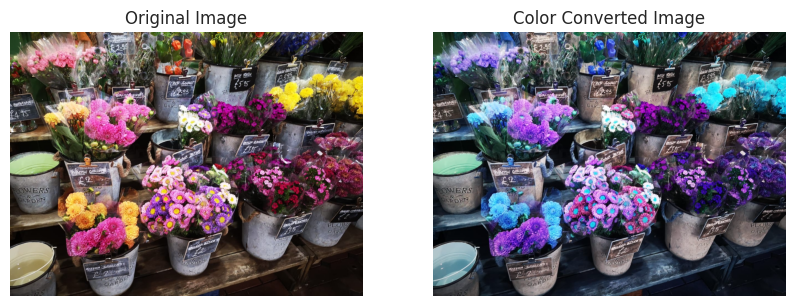

In [ ]:
image = cv2.imread('/content/images/flowers.jpeg')
plt.figure(figsize =(10,7))
plt.subplot(1,2,1)
plt.imshow(cv2.cvtColor(image,cv2.COLOR_BGR2RGB))
plt.axis(False)
plt.title('Original Image')
plt.subplot(1,2,2)
plt.imshow(image)
plt.axis(False)
plt.title("Color Converted Image")
plt.show()

### Saving our Image using `cv2.imwrite("file_name.jpg","image_directory")`

In [ ]:
cv2.imwrite("output.jpeg",image)

True

## Displaying Image Dimensions

In [ ]:
print(image.shape[0])

960


## Greyscalling Image

In [ ]:
def imageshow(image,title="Image",color = cv2.COLOR_BGR2RGB,shape=5,cmap=None,axis=False):
    w, h = image.shape[0], image.shape[1]
    aspect_ratio = w / h
    plt.figure(figsize=(shape * aspect_ratio, shape))
    image_Aug  = cv2.cvtColor(image, color)
    title = f"{title} {image_Aug.shape}"
    plt.imshow(image_Aug,cmap=cmap)
    plt.title(title)
    plt.grid(False)
    plt.axis(axis)
    plt.show()


In [ ]:
image = cv2.imread('/content/images/castara.jpeg')

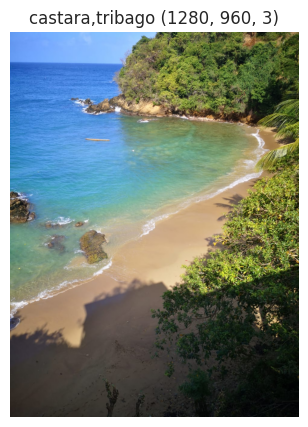

In [ ]:
imageshow(image, title = 'castara,tribago')

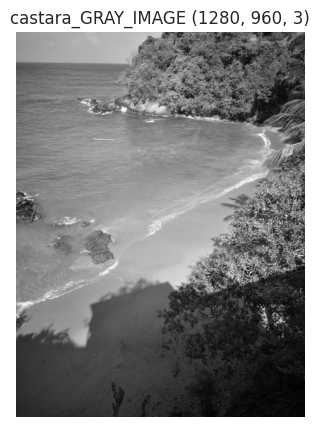

In [ ]:
gray_image = cv2.cvtColor(image,cv2.COLOR_BGR2GRAY)
imageshow(gray_image, title = 'castara_GRAY_IMAGE')

## Color spaces -- RGB and HSV
1. View the indivisiual channels of an RGB image using `cv2.split`
2. Manipulate a color space
3. Introduce HSV color spaces



In [ ]:
B,G,R = cv2.split(image)
B.shape,G.shape,R.shape

((1280, 960), (1280, 960), (1280, 960))

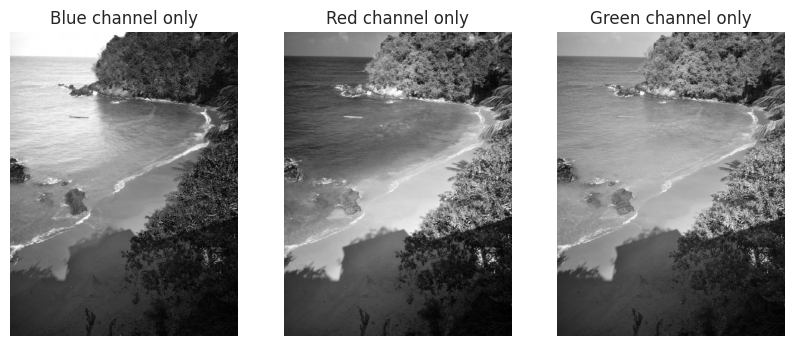

In [ ]:
plt.figure(figsize=(10, 7))

for i in [B, G, R]:
    if i is B:
        title = "Blue"
        y = 1
    elif i is R:
        title = "Red"
        y = 2
    else:
        title = "Green"
        y = 3

    plt.subplot(1, 3, y)
    plt.imshow(i, cmap='gray')  # Use 'cmap' to display grayscale images
    plt.title(f'{title} channel only')
    plt.axis(False)
plt.show()


# imageshow(image=G , title='Green Channel only')
# plt.subplots(3,1,3)
# imageshow(image=R , title='Red Channel only')

# plt.show()

## Creating a single color image using `cv2.merge([ch1,ch2,ch3])`


`cv2.merge` is a function in the OpenCV library that combines multiple single-channel images (grayscale or individual color channels) into a multi-channel image. It essentially takes several single-channel images and merges them into a single multi-channel image.


For example, if you have three separate images representing the Blue, Green, and Red channels of an image, you can use cv2.merge to combine them into a single color image with three channels (BGR), where each channel corresponds to one of the color components.

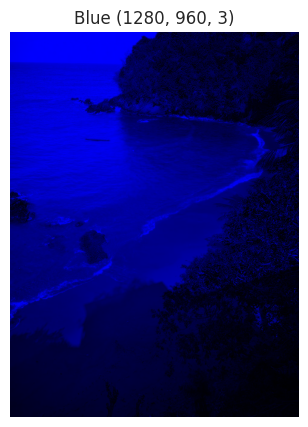

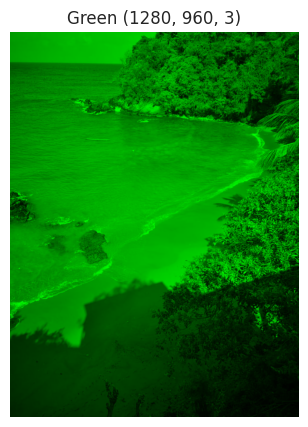

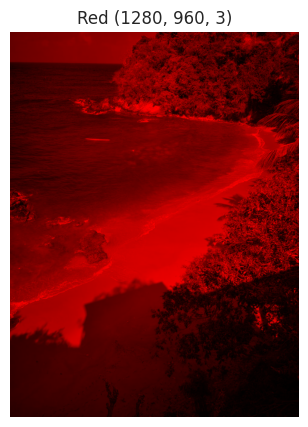

In [ ]:

zeros = np.zeros(image.shape[:2], dtype='uint8')

imageshow(cv2.merge([B, zeros, zeros]), title = 'Blue')
imageshow(cv2.merge([zeros, G, zeros]), title = 'Green')
imageshow(cv2.merge([zeros, zeros, R]), title = 'Red')


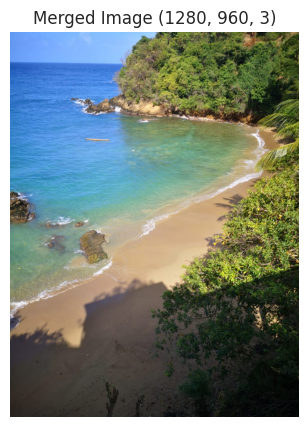

In [ ]:
merged = cv2.merge([B,G,R])

imageshow(merged, title = 'Merged Image')

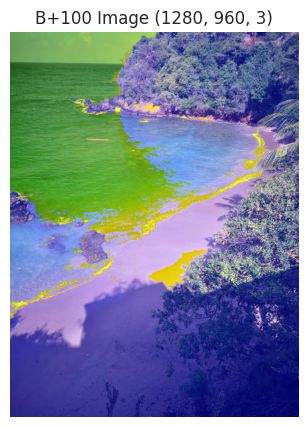

In [ ]:
merged = cv2.merge([B+100,G,R])

imageshow(merged, title = 'B+100 Image')

## HSV Image
HSV stands for Hue, Saturation, and Value, and it is a color space commonly used in image processing and computer vision. Unlike the RGB color space, which represents colors as combinations of red, green, and blue, the HSV color space separates color information into three components:

>`Hue (H)`: Hue represents the dominant wavelength of light that gives a color its name. It is measured in degrees on a circular scale, with values ranging from 0 to 360. In the HSV color space, hue represents the "pure color" or "color tone" of an image.

>`Saturation (S)`: Saturation represents the intensity or purity of the color. It measures how different the color is from a neutral gray of the same brightness. Saturation ranges from 0 (completely unsaturated, grayscale) to 1 (fully saturated, vivid colors).

>`Value (V)`: Value represents the brightness or lightness of the color. It indicates how much light is reflected from a surface. Value ranges from 0 (completely black) to 1 (fully bright or white).

The HSV color space is often used in image processing tasks where it is beneficial to manipulate or analyze color information independently of brightness. For example, it's commonly used in tasks like color segmentation, image processing, and computer vision applications like object tracking and image enhancement. HSV allows you to isolate and work with specific colors more effectively than in the RGB color space, which can be beneficial in various image processing tasks.

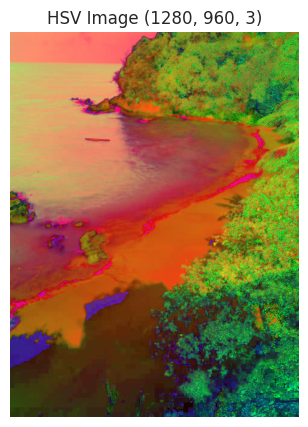

In [ ]:
hsv_image =cv2.cvtColor(image ,cv2.COLOR_BGR2HSV)
imageshow(hsv_image , title = 'HSV Image')

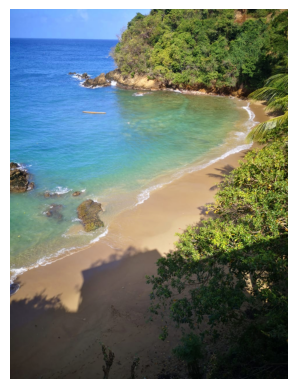

In [ ]:
plt.imshow(cv2.cvtColor(hsv_image,cv2.COLOR_HSV2RGB))
plt.axis(False)
plt.show()

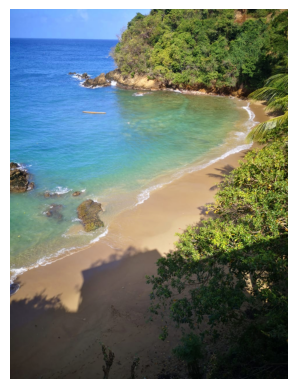

In [ ]:
plt.imshow(cv2.cvtColor(hsv_image, cv2.COLOR_HSV2RGB))
plt.axis(False)
plt.show()

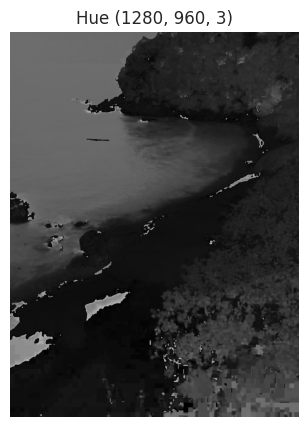

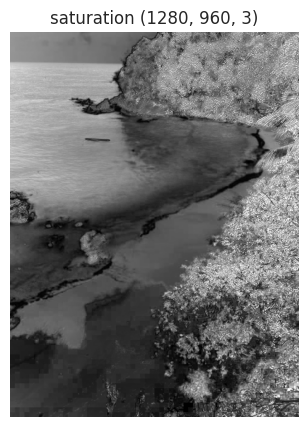

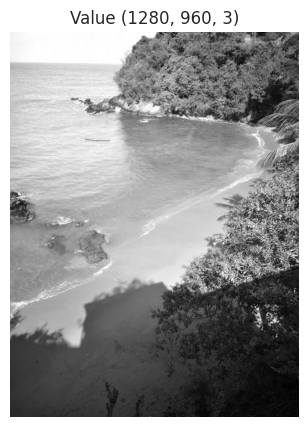

In [ ]:
imageshow(hsv_image[:,:,0] ,title = 'Hue')
imageshow(hsv_image[:,:,1], title = 'saturation')
imageshow(hsv_image[:,:,2] ,title = 'Value')

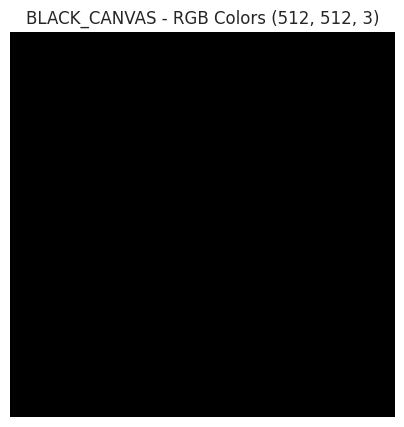

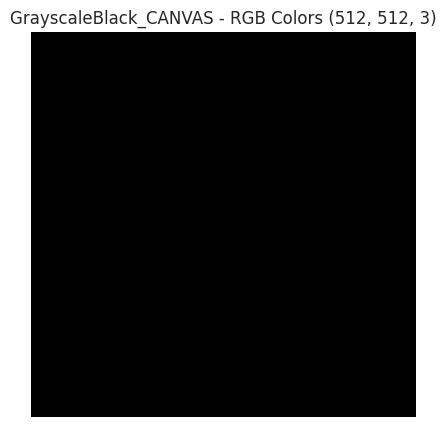

In [ ]:
black_image = np.zeros((512,512,3),dtype = np.uint8)
grayscaleblack_image = np.zeros((512,512,),dtype = np.uint8)

imageshow(black_image,title="BLACK_CANVAS - RGB Colors")
imageshow(grayscaleblack_image,title="GrayscaleBlack_CANVAS - RGB Colors")

## Drawing on Images
1. line                :           `cv2.line -- cv2.line(image, start_point, end_point, color, thickness)`

2. Rectangle           :           `cv2.rectangle -- cv2.rectangle(image, start_point, end_point, color, thickness)`

3. Circle              :           `cv2.Circle -- cv2.circle(image, center_coordinates, radius, color, thickness)`


4. Polygon             :           `cv2.Polylines`
5. Text                :           `cv2.putText -- cv2.putText(image, 'OpenCV', org, font, fontScale, color, thickness, cv2.LINE_AA)`

6. ArrowedLine         :           `cv2.arrowedLine -- cv2.arrowedLine(image, start_point, end_point, color, thickness)`

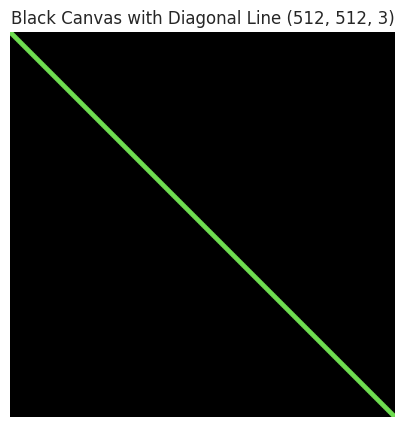

In [ ]:
## drawing line on image
line_image = black_image

cv2.line(line_image,(0,0),(511,511),(80,220,110),5) #
imageshow(line_image , title = 'Black Canvas with Diagonal Line')

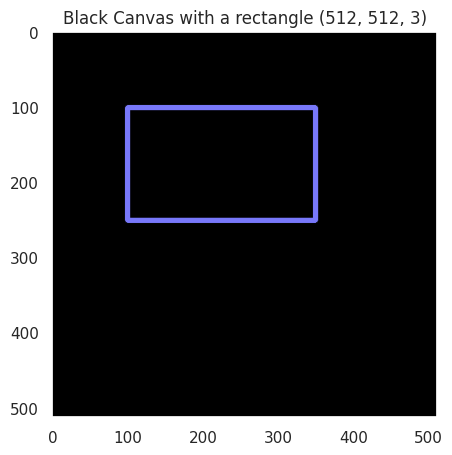

In [ ]:
# drawing Rectangle
rect_image = np.zeros((512,512,3),dtype = np.uint8)
cv2.rectangle(rect_image , (100,100),(350,250),(250,120,120),5)
imageshow(rect_image, title="Black Canvas with a rectangle", axis = True)

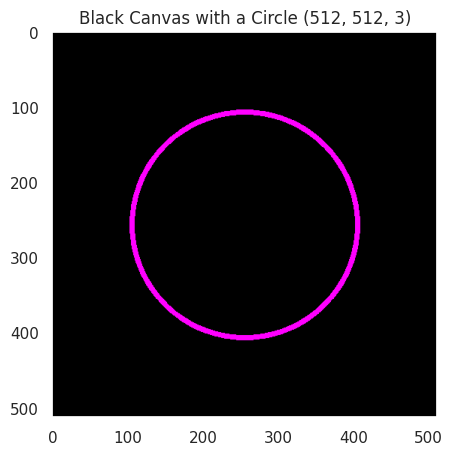

In [ ]:
# Drawing Circle

circle_image = np.zeros((512,512,3),dtype = np.uint8)
cv2.circle(circle_image ,center = (256,256),
           radius =150,
           color =(255,0,255),
           thickness = 5)
imageshow(circle_image, title="Black Canvas with a Circle", axis = True)

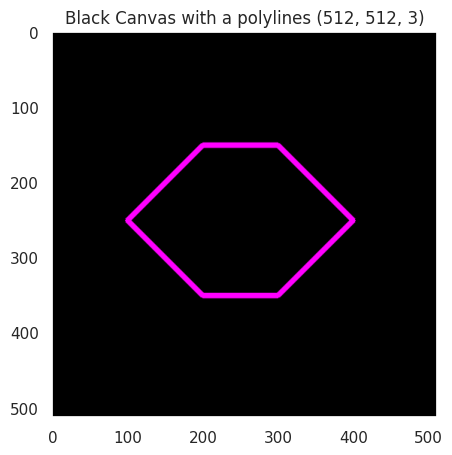

In [ ]:
# Drawing Polylines

pts = np.array([[100, 250], [200, 150], [300, 150], [400, 250],
                     [300, 350], [200, 350]], np.int32)
pts = pts.reshape((-1,1,2))

polygon_image = np.zeros((512,512,3),dtype = np.uint8)
cv2.polylines(polygon_image , [pts] , True , color = (255,0,255),thickness=5 , lineType=10)
imageshow(polygon_image, title="Black Canvas with a polylines", axis = True)

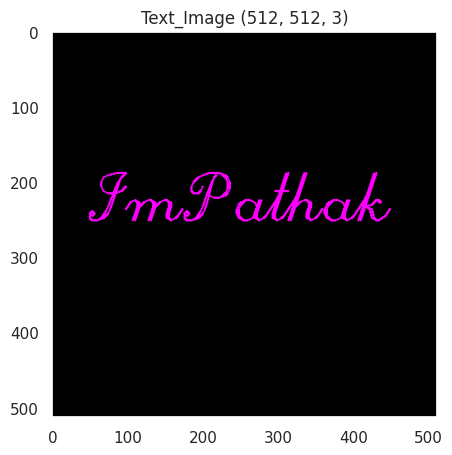

In [ ]:
# Writing text on image

text_image = np.zeros((512,512,3),dtype = np.uint8)
font = cv2.FONT_HERSHEY_SCRIPT_COMPLEX
cv2.putText(text_image,'ImPathak',(50,250), font, 3,(255,0,255),2,4)
imageshow(text_image, title='Text_Image', axis = True)

## Transformation and Rotations
1. Perform Image Transformation
2. Rotations with getRotationaMatrix2D
3. Rotation with Transpose
4. Flipping Images

### Image Transformation

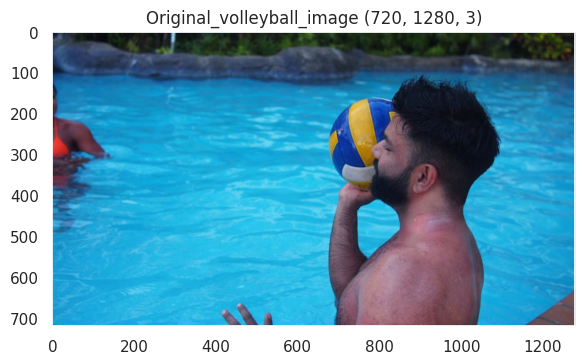

[[  1.   0. 320.]
 [  0.   1. 180.]]


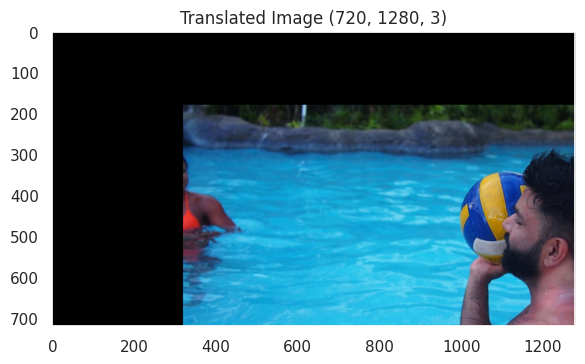

In [ ]:
volleyball_img =cv2.imread('/content/images/Volleyball.jpeg')
imageshow(volleyball_img,title = "Original_volleyball_image",shape =12, axis = True)
height, width = volleyball_img.shape[:2]

quater_height,quater_width = height/4,width/4
T = np.float32([[1,0,quater_width],[0,1,quater_height]])
print(T)
img_translated = cv2.warpAffine(volleyball_img,T,(width,height))
imageshow(img_translated,title = 'Translated Image', shape = 12,axis=True)

### Image Rotation

center: Point2f, angle: float, scale: float

```
height, width = Image.shape[:2]

rotated_matrix = cv2.getRotationMatrix2D((width/2,height/2),90,1)

rotated_image_90 = cv2.warpAffine(Image,rotated_matrix,(width,height))
imageshow(rotated_image_90 , title = 'rotated_image', shape = 12)
```

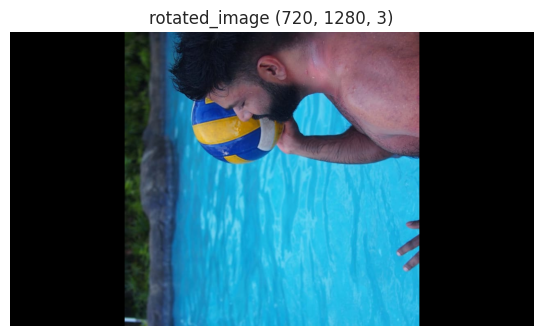

In [ ]:
height, width = volleyball_img.shape[:2]

rotated_matrix = cv2.getRotationMatrix2D((width/2,height/2),90,1)

rotated_image_90 = cv2.warpAffine(volleyball_img,rotated_matrix,(width,height))
imageshow(rotated_image_90 , title = 'rotated_image', shape = 12)

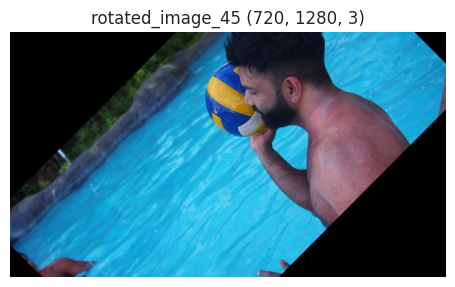

In [ ]:
rotated_matrix = cv2.getRotationMatrix2D((width/2,height/2),45,1)
rotated_image_45 = cv2.warpAffine(volleyball_img , rotated_matrix , (width,height))
imageshow(rotated_image_45 , title = 'rotated_image_45' , shape = 10)

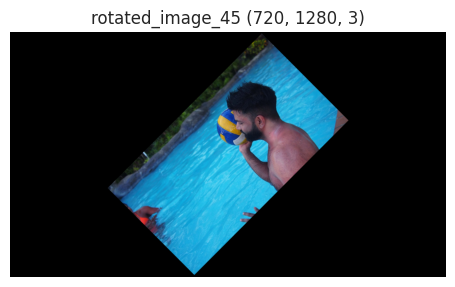

In [ ]:
rotated_matrix = cv2.getRotationMatrix2D((width/2,height/2),45,0.5)
rotated_image_45 = cv2.warpAffine(volleyball_img , rotated_matrix , (width,height))
imageshow(rotated_image_45 , title = 'rotated_image_45' , shape = 10)

### Using Transpose

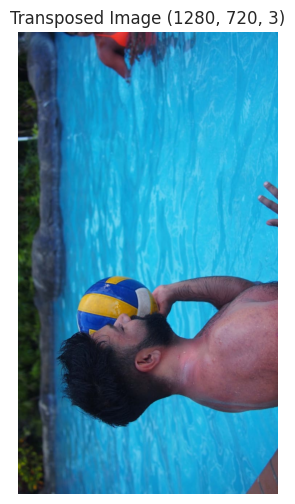

In [ ]:
transposed_image = cv2.transpose(volleyball_img) # flips the image at 90 ACW
# transposed_image = cv2.transpose(transposed_image)

imageshow(transposed_image, title = "Transposed Image", shape = 6)

### Flipping the Image
```
cv2.flip(image , flip_code = 0 -- horizintal,
                             1 -- vertical)
```

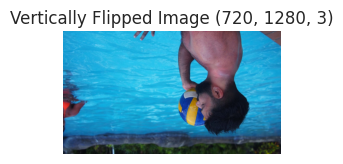

In [ ]:
flipped_image = cv2.flip(volleyball_img,0)

imageshow(flipped_image , title = "Vertically Flipped Image")

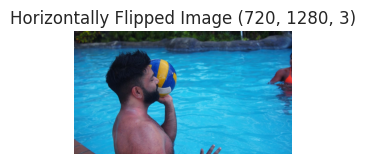

In [ ]:
flipped_image = cv2.flip(volleyball_img,1)

imageshow(flipped_image , title = "Horizontally Flipped Image")

## Scalling , Resizing , Interpolation and Cropping

### Resizing - `cv2.resize(image, dsize(output_image_size), x_scale , y_scale , interpolation)`

interpolation methods

>**cv2. INTER_AREA**------------Good for shrinking or down Sampling

>**cv2. INTER_NEAREST**------Fastest

>**cv2. INTER_LINEAR**---------Good for zooming or sampling

>**cv2. INTER_CUBIC**-----------Better

>cv2. INTER_LANCZOS4---Best

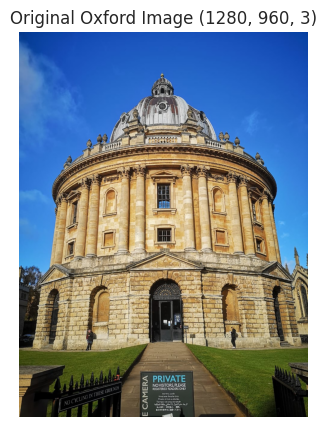

In [ ]:
oxford_img = cv2.imread('/content/images/oxfordlibrary.jpeg')

imageshow(oxford_img , title= 'Original Oxford Image')

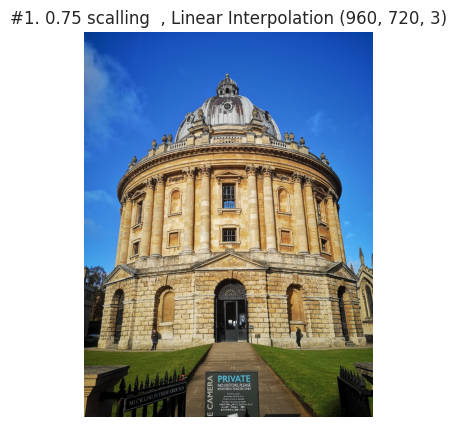

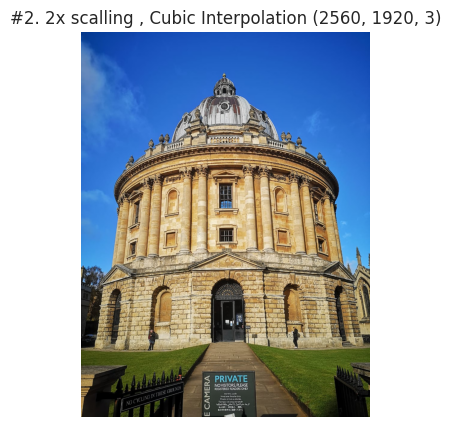

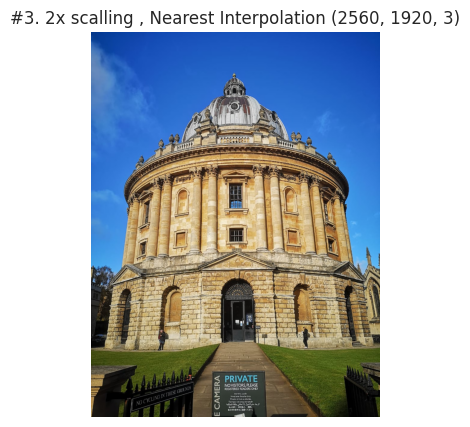

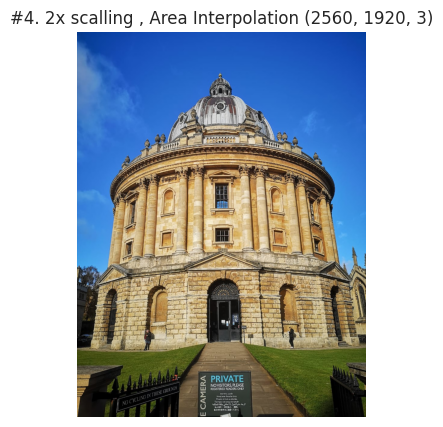

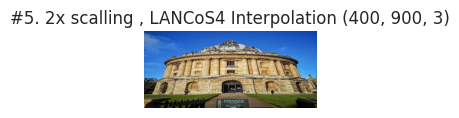

In [ ]:


image_scaled1 = cv2.resize(oxford_img , None , fx = 0.75, fy = 0.75, interpolation=None)
imageshow(image_scaled1, title = f"#1. 0.75 scalling  , Linear Interpolation")


image_scaled2 = cv2.resize(oxford_img , None , fx = 2, fy = 2, interpolation=cv2.INTER_CUBIC)
imageshow(image_scaled2, title = f"#2. 2x scalling , Cubic Interpolation")



image_scaled3 = cv2.resize(oxford_img , None , fx = 2, fy = 2, interpolation=cv2.INTER_NEAREST)
imageshow(image_scaled3, title = f"#3. 2x scalling , Nearest Interpolation")



image_scaled4 = cv2.resize(oxford_img , None , fx = 2, fy = 2, interpolation=cv2.INTER_AREA)
imageshow(image_scaled4, title = f"#4. 2x scalling , Area Interpolation")



image_scaled5 = cv2.resize(oxford_img , (900,400), interpolation=cv2.INTER_LANCZOS4)
imageshow(image_scaled5, title = f"#5. 2x scalling , LANCoS4 Interpolation")



### Image Pyraminds

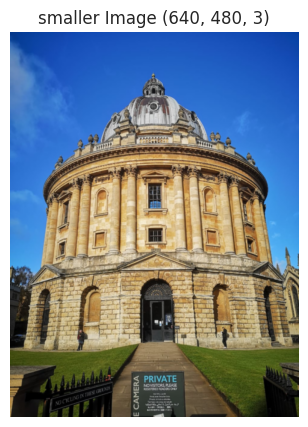

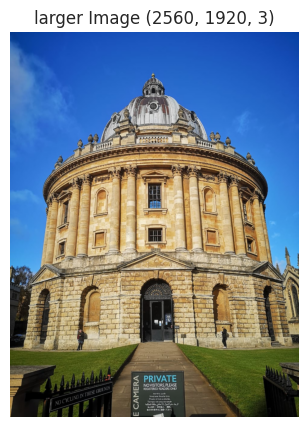

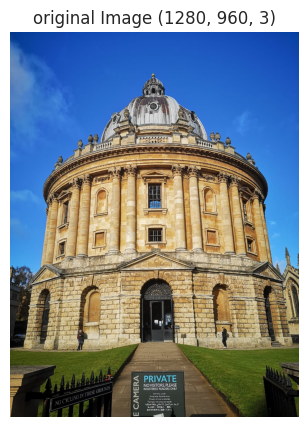

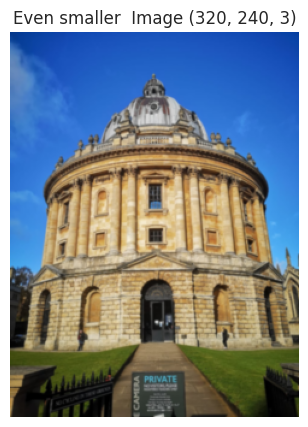

In [ ]:
smaller = cv2.pyrDown(oxford_img) # shrinks the image
larger = cv2.pyrUp(oxford_img) # enlarges the image
even_smaller =cv2.pyrDown(smaller)

imageshow(smaller , title ='smaller Image')
imageshow(larger, title = 'larger Image')
imageshow(oxford_img , title = 'original Image')
imageshow(even_smaller, title = 'Even smaller  Image')

### Croping

In [ ]:
def read_image(image_path , flags = 1):
    image = cv2.imread(image_path ,flags=flags )
    height,width = image.shape[:2]
    return image , height, width


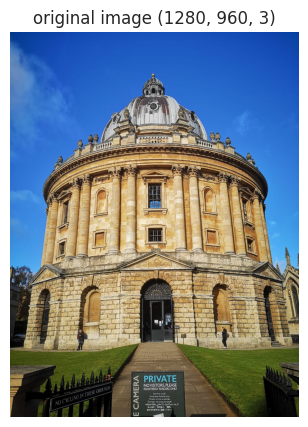

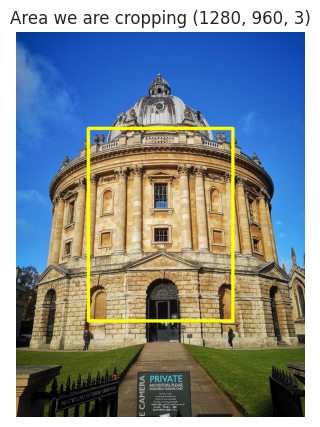

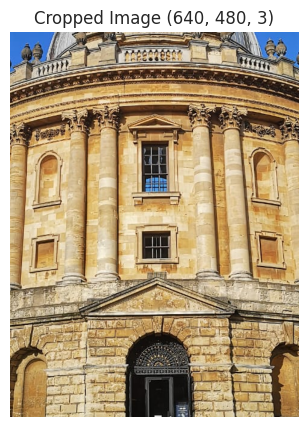

In [ ]:
# getting dimensions of an image
oxford_img , height , width = read_image('/content/images/oxfordlibrary.jpeg')



start_row , start_col = int(height *0.25) , int(width *0.25)
end_row , end_col = int(height *0.75) , int(width *0.75)

cropped = oxford_img[start_row:end_row , start_col:end_col]

imageshow(oxford_img , title = 'original image')
copy = oxford_img.copy()

cv2.rectangle(copy , (start_col,start_row),(end_col,end_row),(0,255,255),10)

imageshow(copy , title = 'Area we are cropping')
imageshow(cropped , title = 'Cropped Image')

## Airthmetic and Bitwise operations

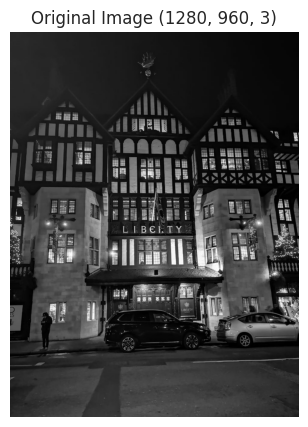

In [ ]:
image ,height,width = read_image('/content/images/liberty.jpeg',0)

imageshow(image , title = 'Original Image')

m = np.ones(image.shape , dtype = 'uint8') * 100


### Increasing Brightness

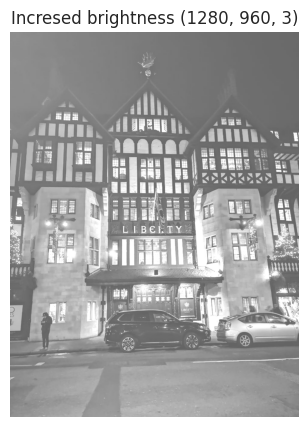

In [ ]:
added = cv2.add(image , m) ## adds the elemnets of two matrices
imageshow(added , title = "Incresed brightness")

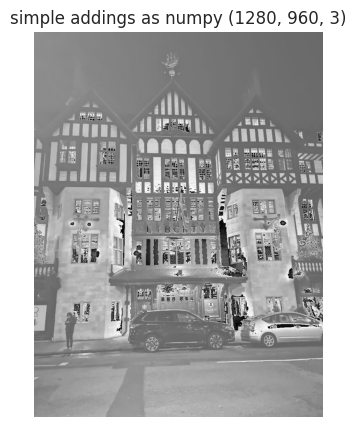

In [ ]:
added2 =image + m
imageshow(added2 , "simple addings as numpy")

In [ ]:
print(f"""
Image matrix :\n {image}\n\n\n
m matrix :\n {m}\n\n\n

added image matrix :\n {added}

added2 img : \n {added}
""")



Image matrix :
 [[41 41 41 ...  5  5  5]
 [41 41 41 ...  5  5  5]
 [41 41 41 ...  5  5  5]
 ...
 [41 42 44 ... 34 33 32]
 [43 44 46 ... 31 30 28]
 [44 45 46 ... 32 30 29]]



m matrix :
 [[100 100 100 ... 100 100 100]
 [100 100 100 ... 100 100 100]
 [100 100 100 ... 100 100 100]
 ...
 [100 100 100 ... 100 100 100]
 [100 100 100 ... 100 100 100]
 [100 100 100 ... 100 100 100]]




added image matrix :
 [[141 141 141 ... 105 105 105]
 [141 141 141 ... 105 105 105]
 [141 141 141 ... 105 105 105]
 ...
 [141 142 144 ... 134 133 132]
 [143 144 146 ... 131 130 128]
 [144 145 146 ... 132 130 129]]

added2 img : 
 [[141 141 141 ... 105 105 105]
 [141 141 141 ... 105 105 105]
 [141 141 141 ... 105 105 105]
 ...
 [141 142 144 ... 134 133 132]
 [143 144 146 ... 131 130 128]
 [144 145 146 ... 132 130 129]]



### Decreasing Brightness

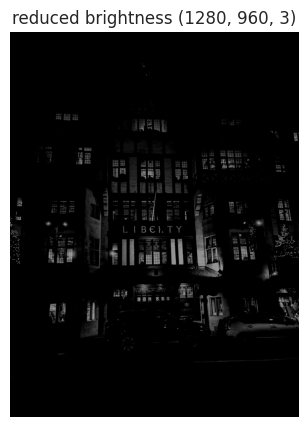

In [ ]:
subtracted = cv2.subtract(image , m)
imageshow(subtracted ,'reduced brightness')

📝**NOTE** - Reason why this added2 and subtracted2 does not work as they supposed to be as image range between(0-255). While adding image
if number is incresed by 255 it starts with 1 again similarly if number is less than 0 , it start with 255.

let's say we get 300 then its true value is 300-255 = 45,
and if we have -55 then its true value is 255-55 = 200,

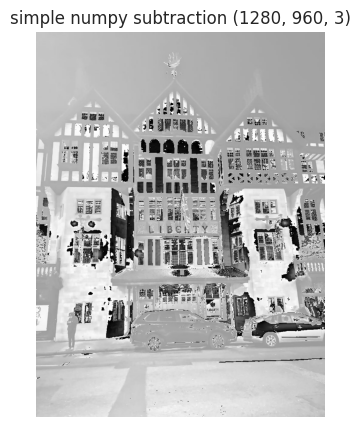

In [ ]:
subtracted2 = image - m ## reason why its not working as above is
imageshow(subtracted2 , "simple numpy subtraction")

In [ ]:
print(f"""
Image matrix :\n {image}\n\n\n
m matrix :\n {m}\n\n\n

subtracted image matrix :\n {subtracted}

asubtracted2 img : \n {subtracted2}
""")



Image matrix :
 [[41 41 41 ...  5  5  5]
 [41 41 41 ...  5  5  5]
 [41 41 41 ...  5  5  5]
 ...
 [41 42 44 ... 34 33 32]
 [43 44 46 ... 31 30 28]
 [44 45 46 ... 32 30 29]]



m matrix :
 [[100 100 100 ... 100 100 100]
 [100 100 100 ... 100 100 100]
 [100 100 100 ... 100 100 100]
 ...
 [100 100 100 ... 100 100 100]
 [100 100 100 ... 100 100 100]
 [100 100 100 ... 100 100 100]]




subtracted image matrix :
 [[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]

asubtracted2 img : 
 [[197 197 197 ... 161 161 161]
 [197 197 197 ... 161 161 161]
 [197 197 197 ... 161 161 161]
 ...
 [197 198 200 ... 190 189 188]
 [199 200 202 ... 187 186 184]
 [200 201 202 ... 188 186 185]]



##Bitwise Operator and Masking

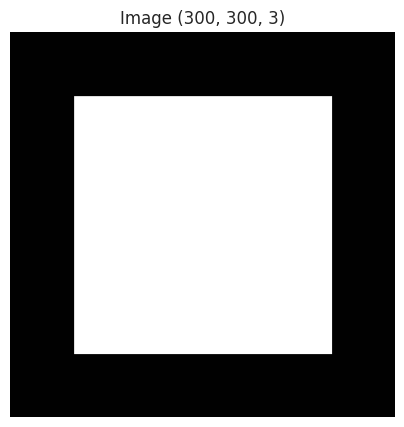

In [ ]:
square = np.ones((300,300), np.uint8)
cv2.rectangle(square ,(50,50),(250,250),(255,255,255),-2)
imageshow(square)

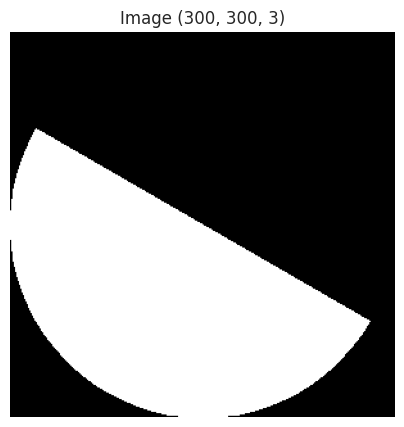

In [ ]:
ellipse = np.zeros((300,300), np.uint8)

cv2.ellipse(ellipse , (150,150),(150,150),30,0,180,255,-1)
imageshow(ellipse)

### Bitwise operations
1. and
2. or
3. xor
4. not

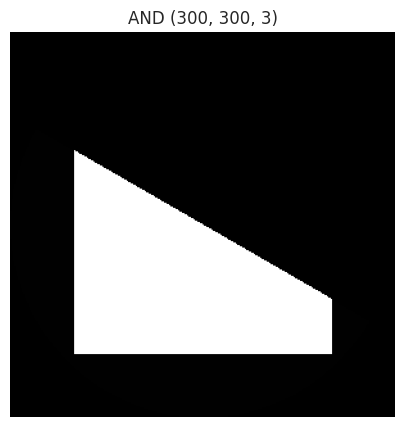

In [ ]:
# Shows only where they intersect
And  = cv2.bitwise_and(square,ellipse)
imageshow(And , "AND")

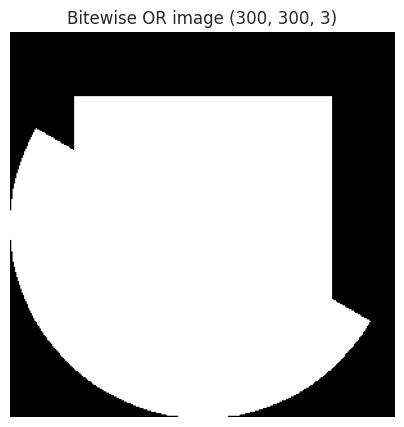

In [ ]:
# shows where either square or ellipse it
bitwiseOr = cv2.bitwise_or(square,ellipse)
imageshow(bitwiseOr , "Bitewise OR image")

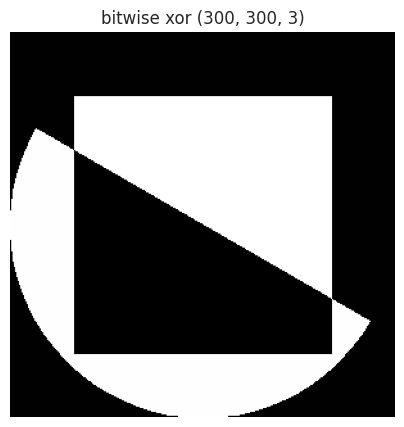

In [ ]:
# shows where either exists for itself
bitwiseXOR = cv2.bitwise_xor(square , ellipse)


imageshow(bitwiseXOR , "bitwise xor")

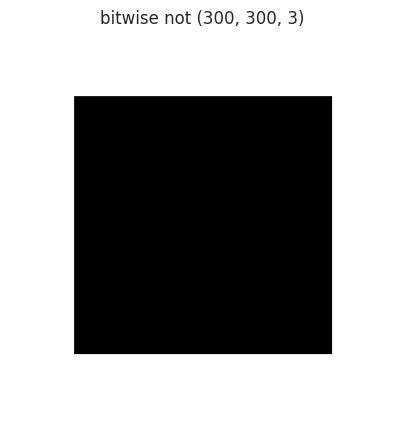

In [ ]:
# Shows everything that isnt part of the square
bitwise_not = cv2.bitwise_not(square)
imageshow(bitwise_not, "bitwise not")

## Convolutions , Blurring and Sharpening Images

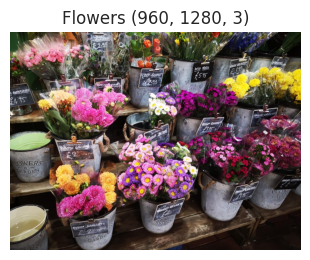

In [ ]:
image , height , width = read_image("/content/images/flowers.jpeg")

imageshow(image , "Flowers" )

### Blurring of image using kernal and Filer2d method

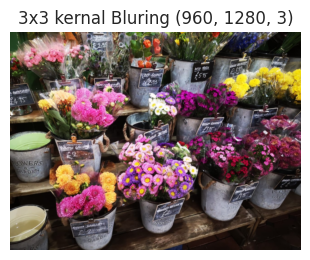

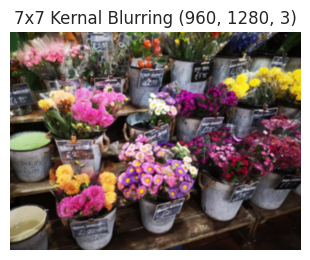

In [ ]:
kernel3x3 = np.ones((3,3),np.float32)/9
blurred = cv2.filter2D(image , -1 , kernel3x3)
imageshow(blurred , "3x3 kernal Bluring")

kernel7x7 = np.ones((7,7),np.float32)/49
blurred2 = cv2.filter2D(image , -1 , kernel7x7)
imageshow(blurred2 , "7x7 Kernal Blurring")



### Other commonly used blurs are
1. Regular Blur
2. Gausian Blur
3. Median Blur

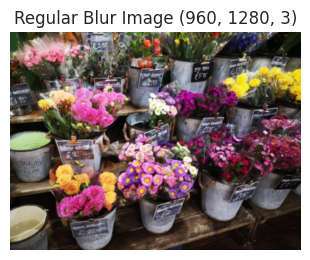

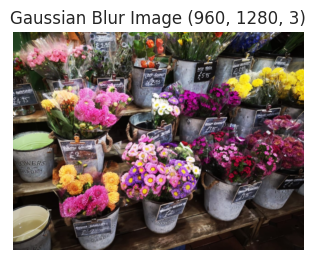

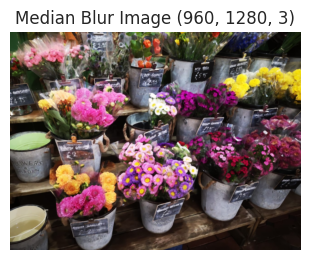

In [ ]:
#regular blur

blur = cv2.blur(image,(5,5))
imageshow(blur , "Regular Blur Image")

gaussian_blur = cv2.GaussianBlur(image,(5,5),0)
imageshow(gaussian_blur , "Gaussian Blur Image")

medianblur = cv2.medianBlur(image,5)
imageshow(medianblur , "Median Blur Image")



### **Bilateral Filter**
 ```dst = cv.bilateralFilter(src, d, sigmaColor, sigmaSpace[, dst[, borderType]])```
- **src**	Source 8-bit or floating-point, 1-channel or 3-channel image.
- **dst**	Destination image of the same size and type as src .
- **d**	Diameter of each pixel neighborhood that is used during filtering. If it is non-positive, it is computed from sigmaSpace.
- **sigmaColor**	Filter sigma in the color space. A larger value of the parameter means that farther colors within the pixel neighborhood (see sigmaSpace) will be mixed together, resulting in larger areas of semi-equal color.
- **sigmaSpace**	Filter sigma in the coordinate space. A larger value of the parameter means that farther pixels will influence each other as long as their colors are close enough (see sigmaColor ). When d>0, it specifies the neighborhood size regardless of sigmaSpace. Otherwise, d is proportional to sigmaSpace.
- **borderType**	border mode used to extrapolate pixels outside of the image

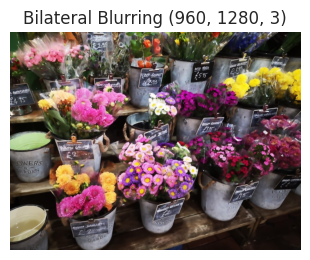

In [ ]:
# Bilateral is very effective in noise removal while keeping edges sharp
bilateral = cv2.bilateralFilter(image, 9, 75, 75)
imageshow(bilateral,'Bilateral Blurring' )

## **Image De-noising - Non-Local Means Denoising**

**There are 4 variations of Non-Local Means Denoising:**

- cv2.fastNlMeansDenoising() - works with a single grayscale images
- cv2.fastNlMeansDenoisingColored() - works with a color image.
- cv2.fastNlMeansDenoisingMulti() - works with image sequence captured in short period of time (grayscale images)
- cv2.fastNlMeansDenoisingColoredMulti() - same as above, but for color images.

```fastNlMeansDenoisingColored(InputArray src, OutputArray dst, float h=3, float hColor=3, int templateWindowSize=7, int searchWindowSize=21 )¶```

#### Parameters for fastNlMeansDenoisingColored:

- **src** – Input 8-bit 3-channel image.
- **dst** – Output image with the same size and type as src .
templateWindowSize – Size in pixels of the template patch that is used to compute weights. Should be odd. Recommended value 7 pixels
- **searchWindowSize** – Size in pixels of the window that is used to compute weighted average for given pixel. Should be odd. Affect performance linearly: greater searchWindowsSize - greater denoising time. Recommended value 21 pixels
- **h** – Parameter regulating filter strength for luminance component. Bigger h value perfectly removes noise but also removes image details, smaller h value preserves details but also preserves some noise
- **hColor** – The same as h but for color components. For most images value equals 10 will be enought to remove colored noise and do not distort colors

In [ ]:
image , height , width = read_image('/content/images/hilton.jpeg')

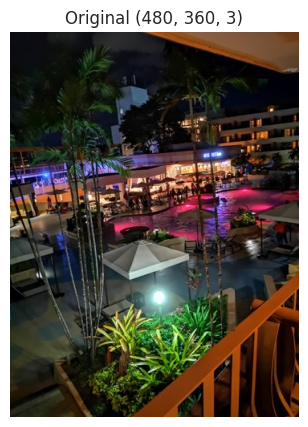

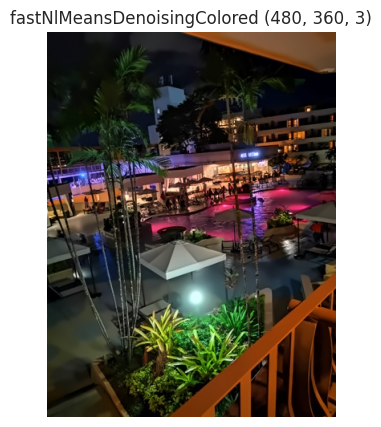

In [ ]:

imageshow(image,title ='Original')

dst = cv2.fastNlMeansDenoisingColored(image, None, 6, 6, 7, 21)
imageshow(dst,title ='fastNlMeansDenoisingColored')

### Sharpening of an Image

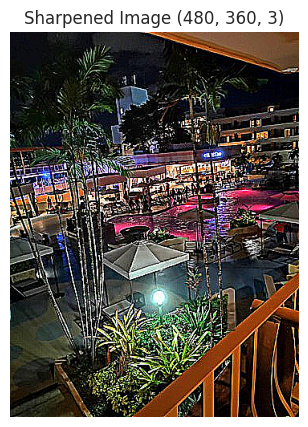

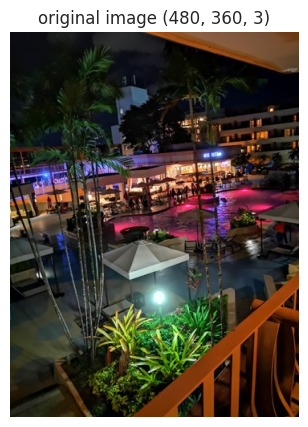

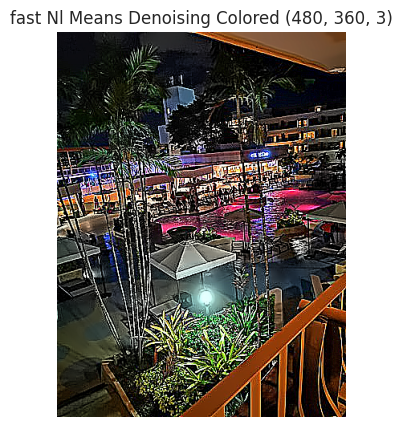

In [ ]:
ker_sharp = np.array([[-1,-1,-1],
                     [-1,9,-1],
                     [-1,-1,-1]])

## applying the sharpening kernel to an image
sharpened = cv2.filter2D(image , -1 , ker_sharp)
imageshow(sharpened , "Sharpened Image")
imageshow(image , "original image")
dst = cv2.fastNlMeansDenoisingColored(sharpened, None, 6, 6, 7, 21)
imageshow(dst,title ='fast Nl Means Denoising Colored')

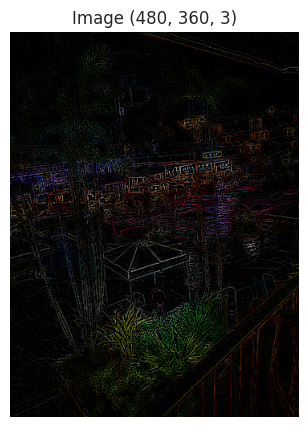

In [ ]:
imageshow(cv2.subtract(image,sharpened))

## Threshold , Binarization and Sharpening of an image

![](https://github.com/rajeevratan84/ModernComputerVision/raw/main/logo_MCV_W.png)

**Thresholding, Binarization & Adaptive Thresholding**

####**In this lesson we'll learn:**
1. Binarized Images
2. Thresholding Methods
3. Adaptive Thresholding
4. SkImage's Threshold Local

```
image =  cv2.threshold((src: MatLike, thresh: float, maxval: float, type: int, dst: MatLike | None = ...) -> tuple[float, MatLike])
```
**src**: This is the first parameter of the function and likely represents the source data or image. It is of type MatLike, which suggests that it's a variable that can be a matrix-like object, such as an image, image data, or a matrix of some sort. The specific type and structure of MatLike would depend on the library or framework being used.

**thresh**: This is the second parameter and is of type float. It seems to represent a threshold value. In image processing, thresholding is often used to separate objects or features in an image based on their intensity or other characteristics.

**maxval**: This is the third parameter and is also of type float. It appears to be the maximum value assigned to elements that meet the threshold condition. Elements in the src that pass the threshold will be assigned this value.

**type**: This is the fourth parameter and is of type int. It likely represents an integer value that specifies the type of thresholding operation to be performed. The exact meaning of different integer values would depend on the specific library or framework used. Different values might correspond to different thresholding methods or options.

**dst**: This is the fifth parameter and is of type MatLike | None. It's an optional parameter, and the | None indicates that it can either be a MatLike object or None. This parameter probably represents the destination where the result of the thresholding operation will be stored. If it's provided, the result will be stored there. If not provided, it might be assumed that the function will create and return a new matrix or object to store the result.

In [ ]:
image = cv2.imread("/content/Scan.jpg")

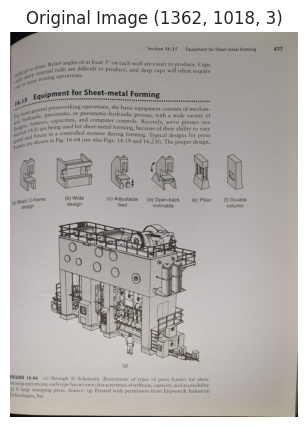

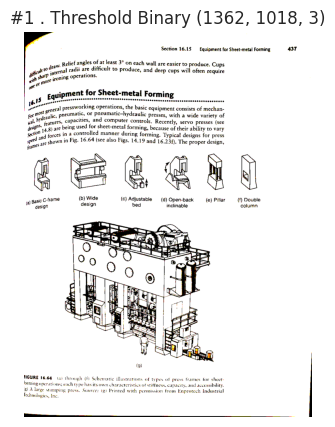

127.0


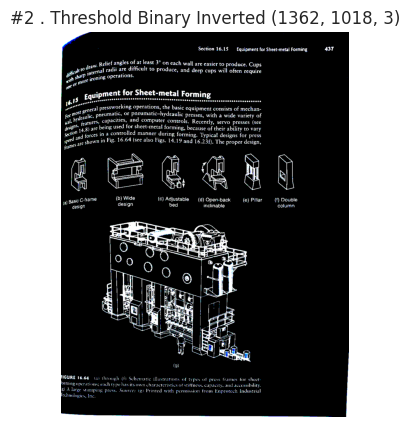

127.0


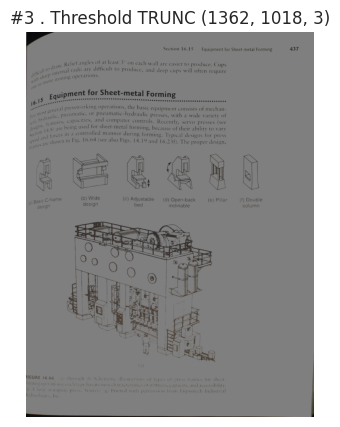

127.0


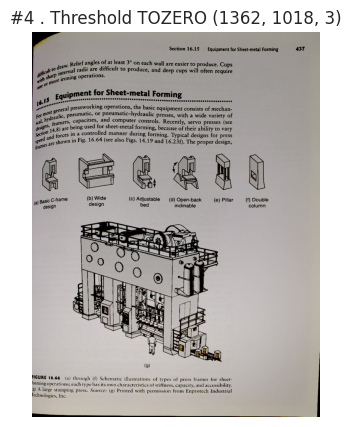

127.0


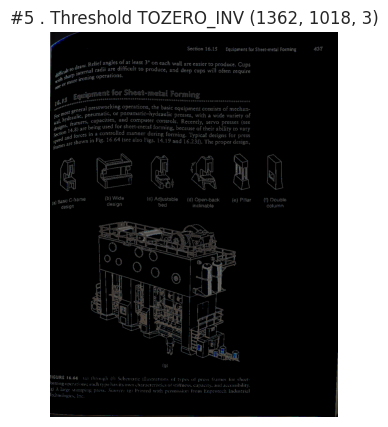

127.0


In [ ]:
imageshow(image , "Original Image")

## Values below 127 goes to 0 or black, everything above goes to 255(white)
ret,thresh1 = cv2.threshold(image ,127,255,cv2.THRESH_BINARY)
imageshow(thresh1 , "#1 . Threshold Binary")
print(ret)

## Values below 127 goes to 255 , everything above goes to 0)
ret,thresh2 = cv2.threshold(image ,127,255,cv2.THRESH_BINARY_INV)
imageshow(thresh2 , "#2 . Threshold Binary Inverted")
print(ret)

# Values above 127 are truncated (held) at 127 (the 255 argument is unused)
ret,thresh3 = cv2.threshold(image ,127,255,cv2.THRESH_TRUNC)
imageshow(thresh3 , "#3 . Threshold TRUNC")
print(ret)

# Values below 127 go to 0, above 127 are unchanged
ret,thresh4 = cv2.threshold(image ,127,255,cv2.THRESH_TOZERO)
imageshow(thresh4 , "#4 . Threshold TOZERO")
print(ret)

#  Reverse of the above, below 127 is unchanged, above 127 goes to 0
ret,thresh5 = cv2.threshold(image ,127,255,cv2.THRESH_TOZERO_INV)
imageshow(thresh5 , "#5 . Threshold TOZERO_INV")
print(ret)


In [ ]:
print(ret)

127.0


## **Adaptive Thresholding**

1. ADAPTIVE_THRESH_MEAN_C
2. THRESH_OTSU

**cv2.adaptiveThreshold Parameters**

``**cv2.adaptiveThreshold**(src, maxValue, adaptiveMethod, thresholdType, blockSize, C[, dst]) → dst``

- **src** – Source 8-bit single-channel image.
- **dst** – Destination image of the same size and the same type as src .
- **maxValue** – Non-zero value assigned to the pixels for which the condition is satisfied. See the details below.
- **adaptiveMethod** – Adaptive thresholding algorithm to use, ADAPTIVE_THRESH_MEAN_C or ADAPTIVE_THRESH_GAUSSIAN_C . See the details below.
- **thresholdType** – Thresholding type that must be either THRESH_BINARY or THRESH_BINARY_INV .
- **blockSize** – Size of a pixel neighborhood that is used to calculate a threshold value for the pixel: 3, 5, 7, and so on.
- **C** – Constant subtracted from the mean or weighted mean. Normally, it is positive but may be zero or negative as well.


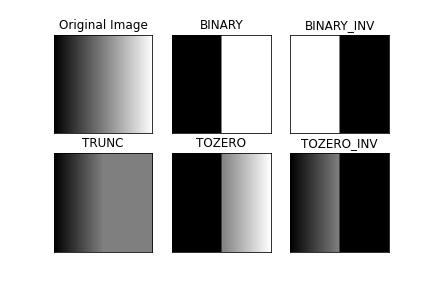


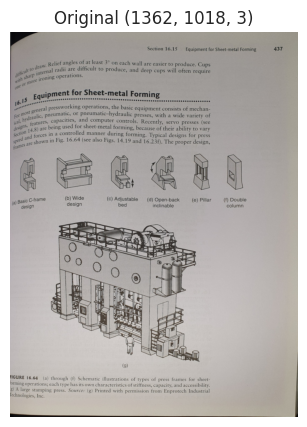

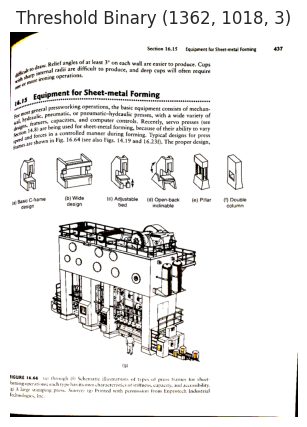

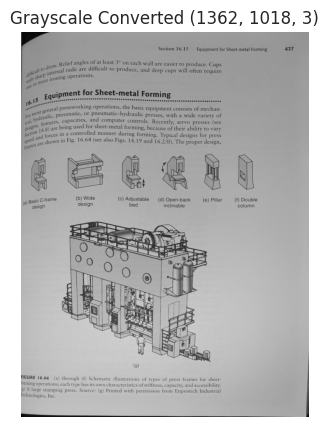

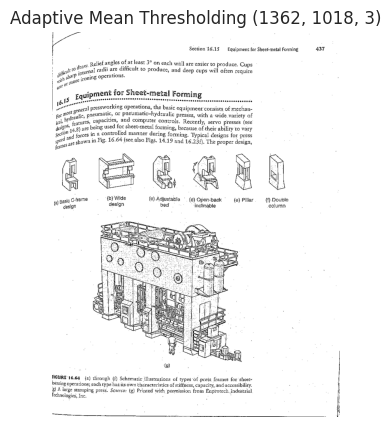

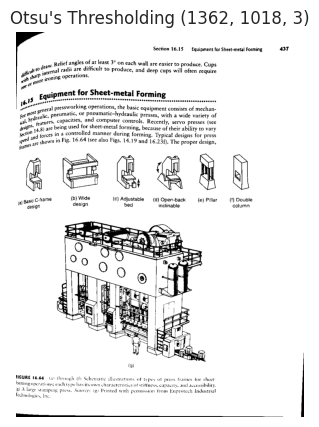

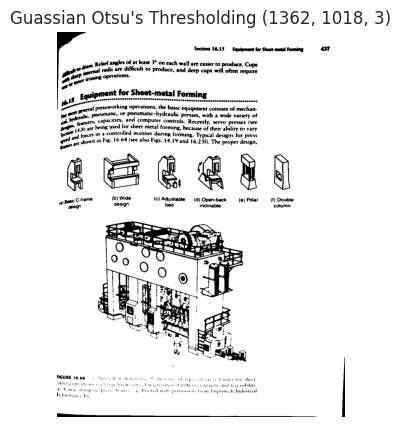

In [ ]:

imageshow(image,"Original")

# Values below 127 goes to 0 (black, everything above goes to 255 (white)
ret,thresh1 = cv2.threshold(image, 127, 255, cv2.THRESH_BINARY)
imageshow(thresh1,'Threshold Binary' )

# It's good practice to blur images as it removes noise
#image = cv2.GaussianBlur(image, (3, 3), 0)

# Using adaptiveThreshold
image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
imageshow(image , "Grayscale Converted")
thresh = cv2.adaptiveThreshold(image, 255, cv2.ADAPTIVE_THRESH_MEAN_C, cv2.THRESH_BINARY, 3, 5)
imageshow( thresh, "Adaptive Mean Thresholding")

_, th2 = cv2.threshold(image, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)
imageshow(th2 , "Otsu's Thresholding" )

# Otsu's thresholding after Gaussian filtering
blur = cv2.GaussianBlur(image, (5,5), 0)
_, th3 = cv2.threshold(blur, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)
imageshow(th3, "Guassian Otsu's Thresholding" )

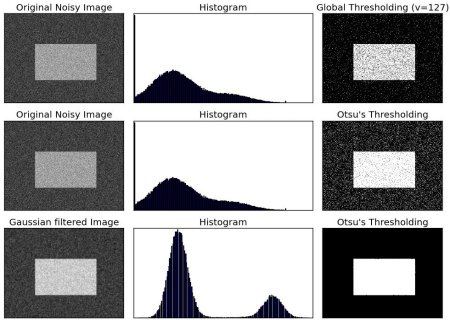

## Skimage Threshold Local



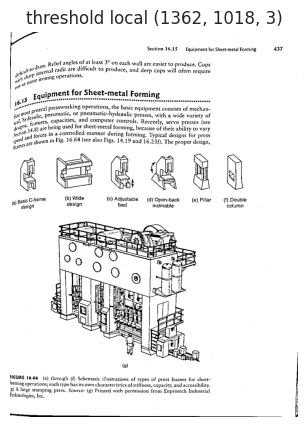

In [ ]:
from skimage.filters import threshold_local

image = cv2.imread('/content/Scan.jpg')

V = cv2.split(cv2.cvtColor(image , cv2.COLOR_BGR2HSV))[2]
T = threshold_local(V,25, offset =15 , method = 'gaussian')


## apply the threshold operation
thresh = (V>T).astype("uint8")*255

imageshow(thresh , 'threshold local')

## Dilation , Erosion and Edge Detection
* **Dilation** - Adds pixels to the boundary of the object in the image

* **Erosion** - Removes pixels to the the boundary of the object in the image
* **Opening** - Erosion followed by dilation
* **Closing** - Dilation foloowed by erosion


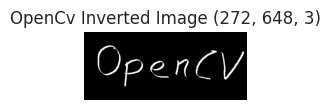

In [ ]:
image = cv2.imread("/content/images/opencv_inv.png")

imageshow(image , "OpenCv Inverted Image")

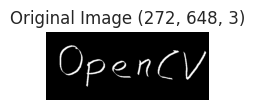

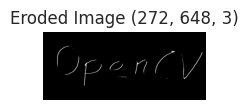

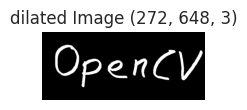

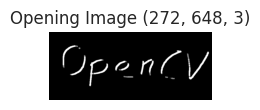

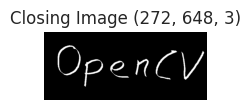

In [ ]:
kernel = np.ones((5,5),np.uint8)

imageshow(image , "Original Image")

erosion = cv2.erode(image , kernel , iterations = 1)
imageshow(erosion , "Eroded Image")

dilation = cv2.dilate(image , kernel ,iterations = 1)
imageshow(dilation , "dilated Image")

opening = cv2.morphologyEx(image , cv2.MORPH_OPEN , kernel)
imageshow(opening , "Opening Image")

closing = cv2.morphologyEx(image , cv2.MORPH_CLOSE, kernel)
imageshow(closing , "Closing Image")

## Canny Edge detection
```
canny = cv2.Canny(image: MatLike, threshold1: float, threshold2: float, edges: MatLike | None = ..., apertureSize: int = ..., L2gradient: bool = ... -> MatLike)
```

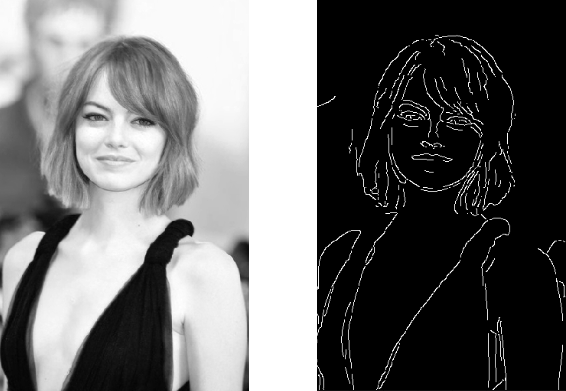

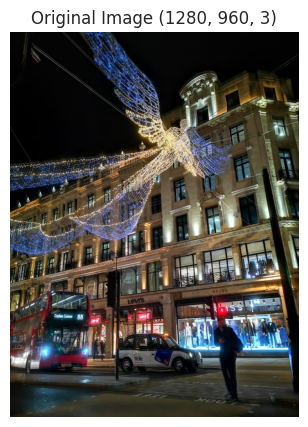

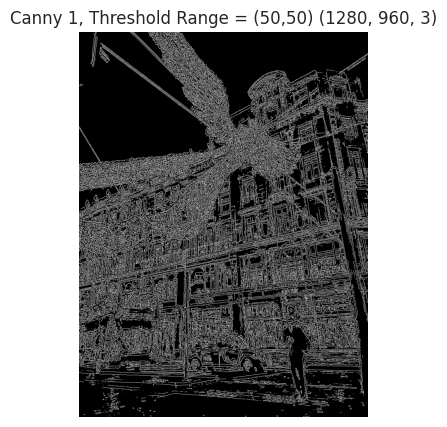

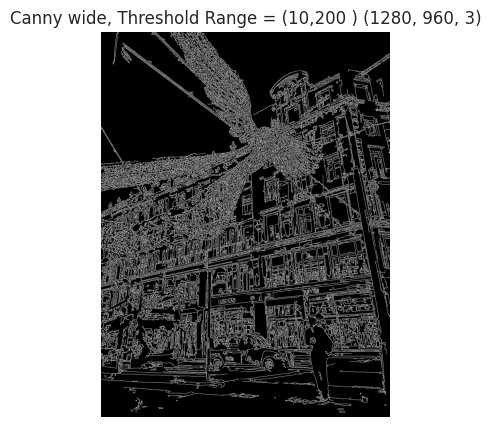

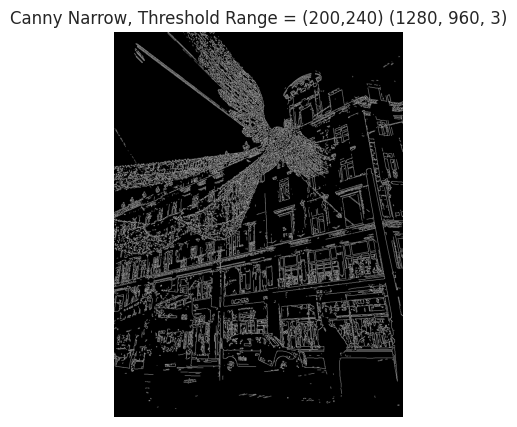

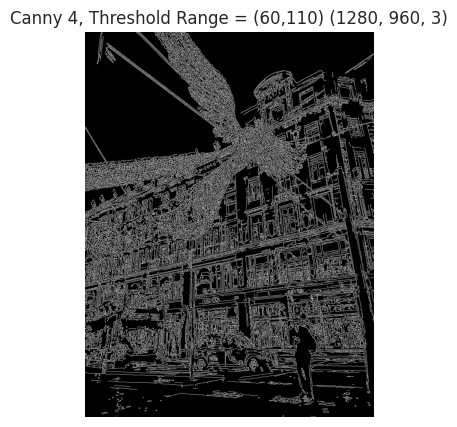

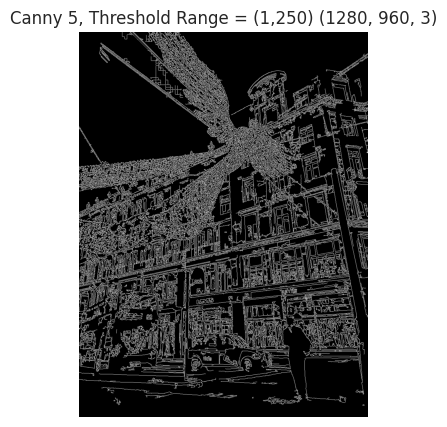

In [ ]:
image = cv2.imread('/content/images/londonxmas.jpeg')
imageshow(image, "Original Image")

canny = cv2.Canny(image , threshold1 = 50 , threshold2 = 50)
imageshow(canny , "Canny 1, Threshold Range = (50,50)")

canny_wide = cv2.Canny(image , 10 ,200)
imageshow(canny_wide , "Canny wide, Threshold Range = (10,200 )")

canny_narrow = cv2.Canny(image , 200 ,240)
imageshow(canny_narrow , "Canny Narrow, Threshold Range = (200,240)")

canny_4 = cv2.Canny(image , 60 , 110)
imageshow(canny_4 , "Canny 4, Threshold Range = (60,110)")

canny_5 = cv2.Canny(image , 1 , 255)
imageshow(canny_5 , "Canny 5, Threshold Range = (1,250)")

### Auto Canny

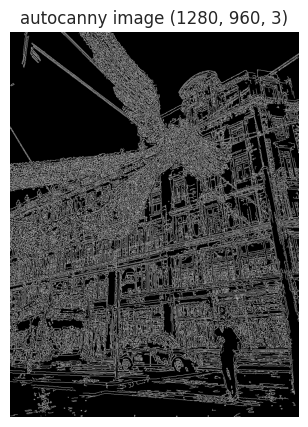

In [ ]:
def autoCanny(image):
    blurred_img = cv2.blur(image , ksize = (5,5))
    med_val = np.median(image)
    lower = int(max(0,0.66*med_val))
    upper = int(min(255,1.33*med_val))
    edges = cv2.Canny(image , lower , upper)
    return edges

auto_canny = autoCanny(image)
imageshow(auto_canny , "autocanny image")

## Contours , Hireachy and Modes
**Contours** - Continious lines or curves that bounds or cover the full boundary of the object
```
countours , hirachy = cv2.findContours(image , Retrival Mode ,  Approximation Method)
```
**image:** This is the input image in which you want to find contours. It should be a grayscale image, and you can obtain it using cv2.imread() or other image loading methods.

**mode:** This parameter specifies the retrieval mode. It determines how the contours are retrieved. Common values are cv2.RETR_EXTERNAL, cv2.RETR_LIST, cv2.RETR_CCOMP, and cv2.RETR_TREE.

**method:** This parameter specifies the approximation method. Common values are cv2.CHAIN_APPROX_NONE, cv2.CHAIN_APPROX_SIMPLE, cv2.CHAIN_APPROX_TC89_L1, and cv2.CHAIN_APPROX_TC89_KCOS.

**contours:**This is an optional argument where you can pass an existing list to store the contours.

**offset:** This is an optional parameter that can be used to add an offset to each point in the contour.

### It seems like you're asking about contours, hierarchy, and modes in the context of image processing or computer vision. Let me provide definitions for each of these terms:

1. **Contours**:
   - Contours in image processing are continuous curves that represent the boundaries of objects in an image. They are essentially a list of points that make up the shape of an object.
   - Contours are useful for various tasks in computer vision, such as object detection, shape analysis, and object recognition.

2. **Hierarchy**:
   - In the context of contour detection, hierarchy refers to the relationship between contours when objects are nested or have a parent-child relationship.
   - The hierarchy information provides details about which contours are inside other contours and how they are organized.
   - The hierarchy is typically represented using a tree structure, where parent-child relationships are defined.

3. **Modes** (assuming you are referring to OpenCV modes):
   - In OpenCV, the term "modes" typically refers to various flags or options that can be set when working with functions related to image processing, contour detection, and other operations.
   - For example, when finding contours in an image using OpenCV, you can specify modes like `CV_RETR_EXTERNAL` to retrieve only the external contours, or `CV_RETR_TREE` to retrieve all contours and create a full hierarchy.
   - Modes in OpenCV allow you to control the behavior of functions to suit your specific needs in image processing tasks.

If you have more specific questions about any of these topics or if you'd like to know how to use them in practice, please provide additional details or questions, and I'd be happy to help further.


#### **Applying cv2.findContours()**

```cv2.findContours(image, Retrieval Mode, Approximation Method)```

**Retrieval Modes**
- **RETR_LIST** - Retrieves all the contours, but doesn't create any parent-child relationship. Parents and kids are equal under this rule, and they are just contours. ie they all belongs to same hierarchy level.
- **RETR_EXTERNAL** - eturns only extreme outer flags. All child contours are left behind.
- **RETR_CCOMP** - This flag retrieves all the contours and arranges them to a 2-level hierarchy. ie external contours of the object (ie its boundary) are placed in hierarchy-1. And the contours of holes inside object (if any) is placed in hierarchy-2. If any object inside it, its contour is placed again in hierarchy-1 only. And its hole in hierarchy-2 and so on.
- **RETR_TREE** -  It retrieves all the contours and creates a full family hierarchy list.

**Approximation Method Options**
- cv2.CHAIN_APPROX_NONE – Stores all the points along the line(inefficient!)
- cv2.CHAIN_APPROX_SIMPLE – Stores the end points of each line




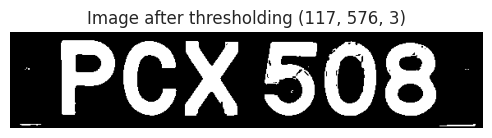

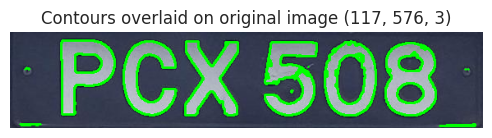

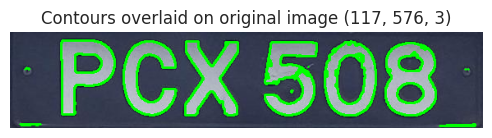

No. of contours found = 38
No. of contours found = 38


In [ ]:
image = cv2.imread("/content/images/LP.jpg")
image1 = cv2.imread("/content/images/LP.jpg")



# creating threshold image to find the countours easily
gray = cv2.cvtColor(image , cv2.COLOR_BGR2GRAY)
_, thr = cv2.threshold(gray , 0 , 255 , cv2.THRESH_BINARY + cv2.THRESH_OTSU)
imageshow(thr , "Image after thresholding" , shape =30)
# Finding contours

contours1 , hirachy = cv2.findContours(thr,cv2.RETR_LIST , cv2.CHAIN_APPROX_NONE)
# Drawing Countours
cv2.drawContours(image , contours1, -1 , (0,255,0), thickness = 2)
imageshow(image , "Contours overlaid on original image", shape = 30)

contours2 , hirachy = cv2.findContours(thr,cv2.RETR_LIST , cv2.CHAIN_APPROX_SIMPLE)
# Drawing Countours
cv2.drawContours(image1 , contours2, -1 , (0,255,0), thickness = 2)
imageshow(image , "Contours overlaid on original image", shape = 30)


print(f"No. of contours found = {str(len(contours1))}")
print(f"No. of contours found = {str(len(contours2))}")

In [ ]:
contours2[0][:5]

array([[[564, 112]],

       [[563, 113]],

       [[532, 113]],

       [[531, 114]],

       [[523, 114]]], dtype=int32)

### 📝 **NOTE** - For finding Contours with findcontours the background has to be black and foreground(i.e the text or objects)


Otherwise we need to invert the image with cv2.bitwise_not(input_image)

### We Can use Canny images to find the countours

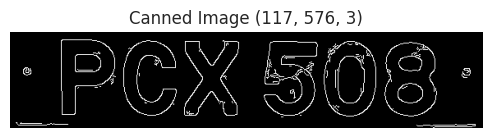

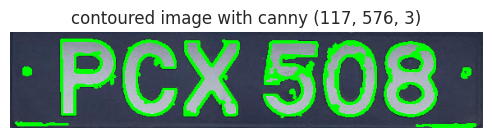

No of contours : 77


In [ ]:
edged = cv2.Canny(gray , 30 ,200)
imageshow(edged , "Canned Image" , shape = 30)

contour , hirachy = cv2.findContours(edged , cv2.RETR_LIST , cv2.CHAIN_APPROX_NONE)

cv2.drawContours(image , contour , -1 ,(0,255,0), thickness= 2)
imageshow(image , "contoured image with canny",shape = 30)
print(f"No of contours : {int(len(contour))}")

### Method RETR_CCOMP

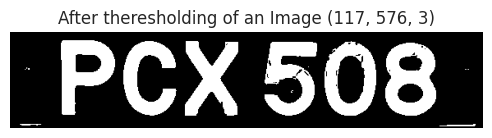

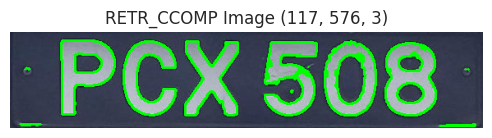

len of contours : 38
[[[ 1 -1 -1 -1]
  [ 2  0 -1 -1]
  [ 3  1 -1 -1]
  [ 4  2 -1 -1]
  [ 5  3 -1 -1]
  [ 6  4 -1 -1]
  [ 7  5 -1 -1]
  [ 8  6 -1 -1]
  [ 9  7 -1 -1]
  [10  8 -1 -1]
  [17  9 11 -1]
  [12 -1 -1 10]
  [13 11 -1 10]
  [14 12 -1 10]
  [15 13 -1 10]
  [16 14 -1 10]
  [-1 15 -1 10]
  [25 10 18 -1]
  [19 -1 -1 17]
  [20 18 -1 17]
  [21 19 -1 17]
  [22 20 -1 17]
  [23 21 -1 17]
  [24 22 -1 17]
  [-1 23 -1 17]
  [32 17 26 -1]
  [27 -1 -1 25]
  [28 26 -1 25]
  [29 27 -1 25]
  [30 28 -1 25]
  [31 29 -1 25]
  [-1 30 -1 25]
  [35 25 33 -1]
  [34 -1 -1 32]
  [-1 33 -1 32]
  [36 32 -1 -1]
  [-1 35 37 -1]
  [-1 -1 -1 36]]]


In [ ]:
image = cv2.imread("/content/images/LP.jpg")

gray = cv2.cvtColor(image , cv2.COLOR_BGR2GRAY)
_,th2 = cv2.threshold(gray , 0 , 255 , cv2.THRESH_BINARY + cv2.THRESH_OTSU)
imageshow(th2, "After theresholding of an Image" , shape = 30)

contour , hirachy = cv2.findContours(th2,cv2.RETR_CCOMP,cv2.CHAIN_APPROX_NONE)

cv2.drawContours(image , contour , -1 , (0,255,0) , thickness = 2)
imageshow(image , "RETR_CCOMP Image" , shape = 30)

print(f"len of contours : {int(len(contour))}")
print(hirachy)

### Method RETR_TREE

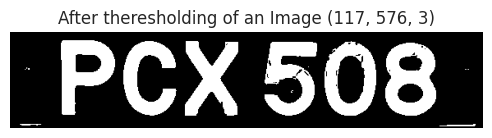

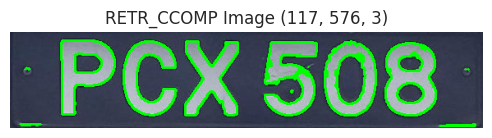

len of contours : 38
(1, 38, 4)


In [ ]:
image = cv2.imread("/content/images/LP.jpg")

gray = cv2.cvtColor(image , cv2.COLOR_BGR2GRAY)
_,th2 = cv2.threshold(gray , 0 , 255 , cv2.THRESH_BINARY + cv2.THRESH_OTSU)
imageshow(th2, "After theresholding of an Image" , shape = 30)

contour , hirachy = cv2.findContours(th2,cv2.RETR_TREE,cv2.CHAIN_APPROX_NONE)

cv2.drawContours(image , contour , -1 , (0,255,0) , thickness = 2)
imageshow(image , "RETR_CCOMP Image" , shape = 30)

print(f"len of contours : {int(len(contour))}")
print(hirachy.shape)

### Countouring Modes: CHAIN_APPROX_NONE AND CHAIN_APPROX_SIMPLE

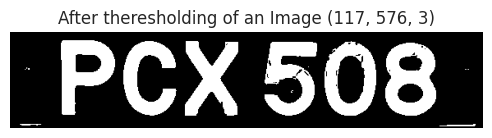

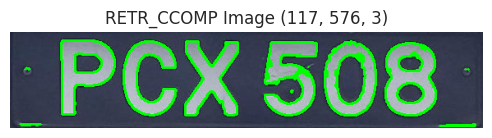

len of contours : 38
[[[ 1 -1 -1 -1]
  [ 2  0 -1 -1]
  [ 3  1 -1 -1]
  [ 4  2 -1 -1]
  [ 5  3 -1 -1]
  [ 6  4 -1 -1]
  [ 7  5 -1 -1]
  [ 8  6 -1 -1]
  [ 9  7 -1 -1]
  [10  8 -1 -1]
  [17  9 11 -1]
  [12 -1 -1 10]
  [13 11 -1 10]
  [14 12 -1 10]
  [15 13 -1 10]
  [16 14 -1 10]
  [-1 15 -1 10]
  [25 10 18 -1]
  [19 -1 -1 17]
  [20 18 -1 17]
  [21 19 -1 17]
  [22 20 -1 17]
  [23 21 -1 17]
  [24 22 -1 17]
  [-1 23 -1 17]
  [32 17 26 -1]
  [27 -1 -1 25]
  [28 26 -1 25]
  [29 27 -1 25]
  [30 28 -1 25]
  [31 29 -1 25]
  [-1 30 -1 25]
  [35 25 33 -1]
  [34 -1 -1 32]
  [-1 33 -1 32]
  [36 32 -1 -1]
  [-1 35 37 -1]
  [-1 -1 -1 36]]]


In [ ]:
image = cv2.imread("/content/images/LP.jpg")

gray = cv2.cvtColor(image , cv2.COLOR_BGR2GRAY)
_,th2 = cv2.threshold(gray , 0 , 255 , cv2.THRESH_BINARY + cv2.THRESH_OTSU)
imageshow(th2, "After theresholding of an Image" , shape = 30)

contour , hirachy = cv2.findContours(th2,cv2.RETR_TREE,cv2.CHAIN_APPROX_SIMPLE)

cv2.drawContours(image , contour , -1 , (0,255,0) , thickness = 2)
imageshow(image , "RETR_CCOMP Image" , shape = 30)

print(f"len of contours : {int(len(contour))}")
print(hirachy)

## Moments , Sorting , Approximation and Matching Contours
![](https://github.com/rajeevratan84/ModernComputerVision/raw/main/logo_MCV_W.png)
# **Moments, Sorting, Approximating & Matching Contours**

####**In this lesson we'll learn:**
1. Sort Contours by Area
2. Sort by Left to Right (Great for OCR)
3. Approximate Contours
4. Convex Hull

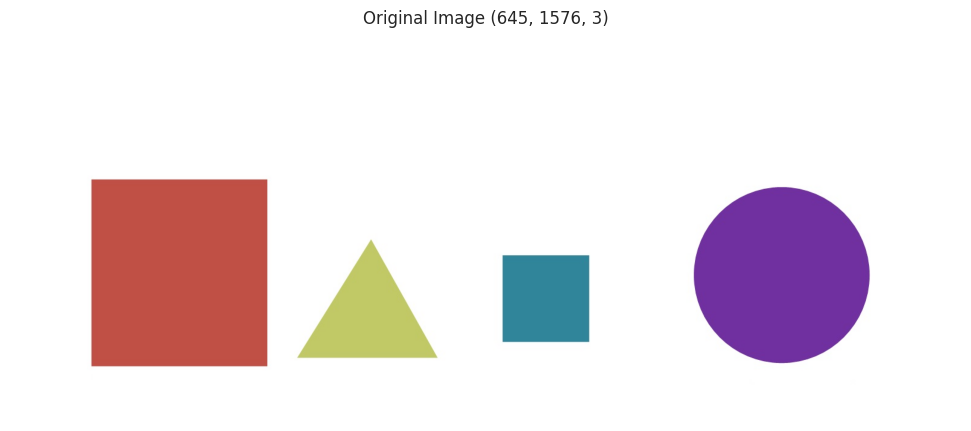

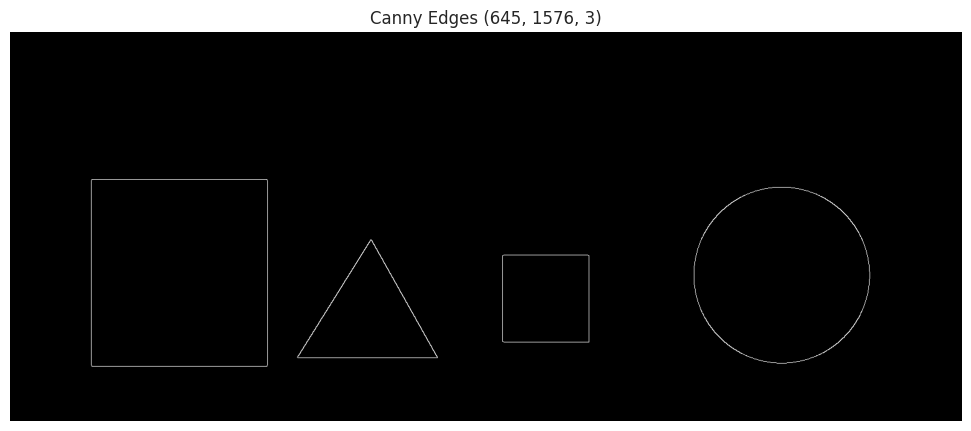

Number of contours found =  4


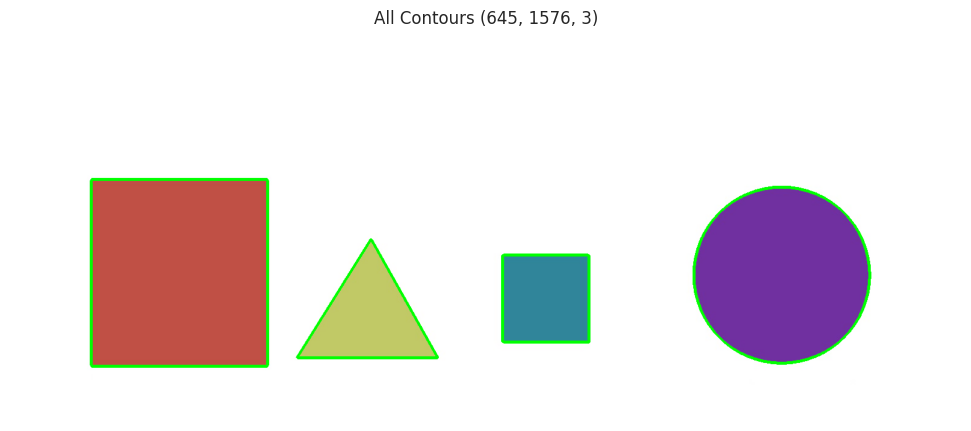

In [ ]:
# Load our image
image = cv2.imread('/content/images/bunchofshapes.jpg')
imageshow(image,'Original Image',shape = 30)

# Grayscale our image
gray = cv2.cvtColor(image,cv2.COLOR_BGR2GRAY)

# Find Canny edges
edged = cv2.Canny(gray, 50, 200)
imageshow( edged,'Canny Edges',shape = 30)

# Find contours and print how many were found
contours, hierarchy = cv2.findContours(edged.copy(), cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_NONE)
print("Number of contours found = ", len(contours))

# Draw all contours over blank image
cv2.drawContours(image, contours, -1, (0,255,0), 3)
imageshow(image,'All Contours' ,shape = 30)

## Sorting by Area using cv2.ContourArea and cv2.Moments

Contour area before sorting
[20587.5, 22901.5, 66579.5, 90222.0]
Contours area After sorting
[90222.0, 66579.5, 22901.5, 20587.5]


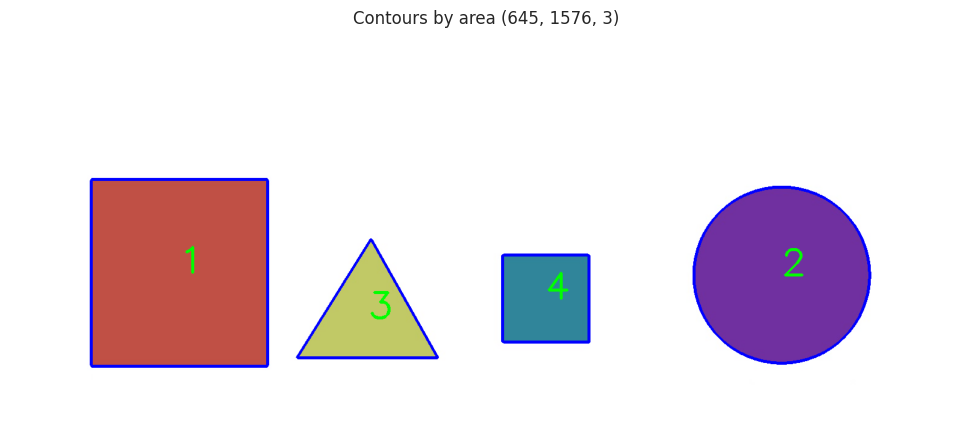

In [ ]:
def get_contour_areas(contours):
    """ return the areas of all countours as a list """

    all_areas = []
    for cnt in contours:
        area = cv2.contourArea(cnt)
        all_areas.append(area)
    return all_areas

image = cv2.imread("/content/images/bunchofshapes.jpg")

print("Contour area before sorting")
print(get_contour_areas(contours))

sorted_contours = sorted(contours , key = cv2.contourArea , reverse = True)

print("Contours area After sorting")
print(get_contour_areas(sorted_contours))

# iterate over our contours and draw at one time
for (i,c) in enumerate(sorted_contours):
    M = cv2.moments(c)
    cx = int(M["m10"] / M["m00"])
    cy = int(M["m01"] / M["m00"])
    cv2.putText(image, str(i+1), (cx, cy), cv2.FONT_HERSHEY_SIMPLEX, 2, (0, 255, 0), 3)
    cv2.drawContours(image, [c], -1, (255,0,0), 3)

imageshow( image,'Contours by area',shape = 30)

In [ ]:
# Functions we'll use for sorting by position
def x_cord_contour(contours):
    """Returns the X cordinate for the contour centroid"""
    if cv2.contourArea(contours) > 10:
        M = cv2.moments(contours)
        return (int(M['m10']/M['m00']))
    else:
        pass

def label_contour_center(image, c):
    """Places a red circle on the centers of contours"""
    M = cv2.moments(c)
    cx = int(M['m10'] / M['m00'])
    cy = int(M['m01'] / M['m00'])

    # Draw the countour number on the image
    cv2.circle(image,(cx,cy), 10, (0,0,255), -1)
    return image

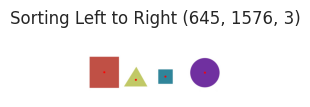

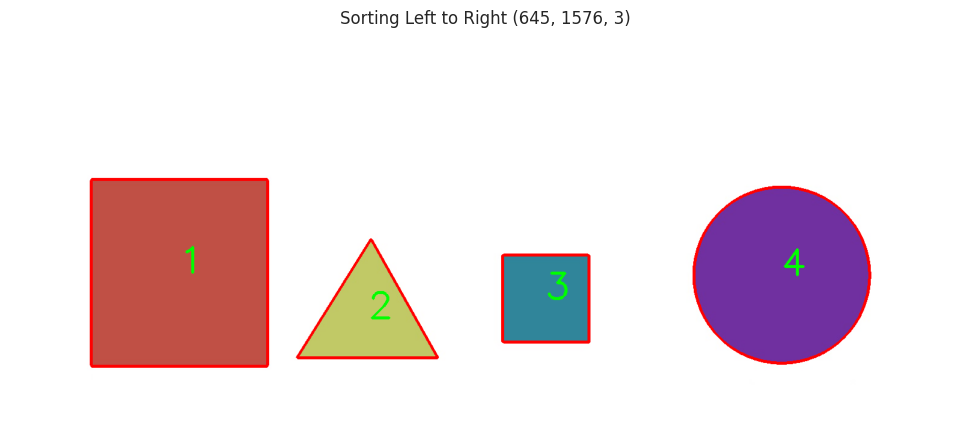

In [ ]:
# Load our image
image = cv2.imread('images/bunchofshapes.jpg')
orginal_image = image.copy()

# Computer Center of Mass or centroids and draw them on our image
for (i, c) in enumerate(contours):
    orig = label_contour_center(image, c)

# Showing the Contour centers
imageshow( image,"Sorting Left to Right")

# Sort by left to right using our x_cord_contour function
contours_left_to_right = sorted(contours, key = x_cord_contour, reverse = False)

# Labeling Contours left to right
for (i,c)  in enumerate(contours_left_to_right):
    cv2.drawContours(orginal_image, [c], -1, (0,0,255), 3)
    M = cv2.moments(c)
    cx = int(M['m10'] / M['m00'])
    cy = int(M['m01'] / M['m00'])
    cv2.putText(orginal_image, str(i+1), (cx, cy), cv2.FONT_HERSHEY_SIMPLEX, 2, (0, 255, 0), 3)
    (x, y, w, h) = cv2.boundingRect(c)

imageshow(orginal_image,'Sorting Left to Right',shape = 30)

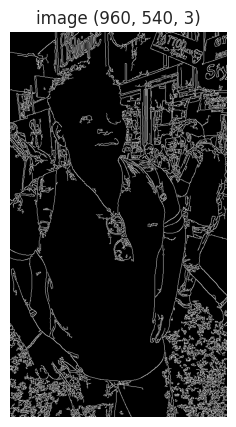

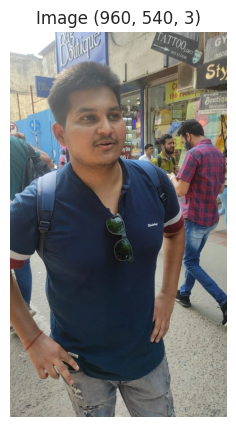

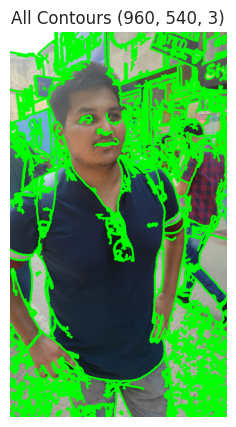

In [ ]:
wp = cv2.imread("/content/WhatsApp Image 2023-11-06 at 08.38.09_4a5a22d3.jpg")

canned_wp = cv2.Canny(wp,1, 255 )

imageshow(canned_wp ,"image")
imageshow(wp)

# Find contours and print how many were found
contours, hierarchy = cv2.findContours(canned_wp, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
# print("Number of contours found = ", len(contours))

# Draw all contours over blank image
cv2.drawContours(wp, contours, -1, (0,255,0), 3)
imageshow(wp,'All Contours' )

## LINE , CIRCLE AND BLOB DETECTION

```
cv2.HoughLines(image: MatLike, rho: float, theta: float, threshold: int, lines: MatLike | None = ..., srn: float = ..., stn: float = ..., min_theta: float = ..., max_theta: float = ...) -> MatLike)
```
```
HoughLines(image, rho, theta, threshold[, lines[, srn[, stn[, min_theta[, max_theta]]]]]) -> lines
*   @brief Finds lines in a binary image using the standard Hough transform.
.   
*   The function implements the standard or standard multi-scale Hough transform algorithm for line detection. See <http://homepages.inf.ed.ac.uk/rbf/HIPR2/hough.htm> for a good explanation of Hough
.   transform.
.   
* $ .   @param image 8-bit, single-channel binary source image. The image may be modified by the function.
* .   @param lines Output vector of lines. Each line is represented by a 2 or 3 element vector
.   \f$(\rho, \theta)\f$ or \f$(\rho, \theta, \textrm{votes})\f$, where \f$\rho\f$ is the distance from
.   the coordinate origin \f$(0,0)\f$ (top-left corner of the image), \f$\theta\f$ is the line rotation
.   angle in radians ( \f$0 \sim \textrm{vertical line}, \pi/2 \sim \textrm{horizontal line}\f$ ), and
.   \f$\textrm{votes}\f$ is the value of accumulator.
.   @param rho Distance resolution of the accumulator in pixels.
.   @param theta Angle resolution of the accumulator in radians.
.   @param threshold %Accumulator threshold parameter. Only those lines are returned that get enough
.   votes ( \f$>\texttt{threshold}\f$ ).
.   @param srn For the multi-scale Hough transform, it is a divisor for the distance resolution rho.
.   The coarse accumulator distance resolution is rho and the accurate accumulator resolution is
.   rho/srn. If both srn=0 and stn=0, the classical Hough transform is used. Otherwise, both these
.   parameters should be positive.
.   @param stn For the multi-scale Hough transform, it is a divisor for the distance resolution theta.
.   @param min_theta For standard and multi-scale Hough transform, minimum angle to check for lines.
.   Must fall between 0 and max_theta.
.   @param max_theta For standard and multi-scale Hough transform, an upper bound for the angle.
.   Must fall between min_theta and CV_PI. The actual maximum angle in the accumulator may be slightly
.   less than max_theta, depending on the parameters min_theta and theta. $
```

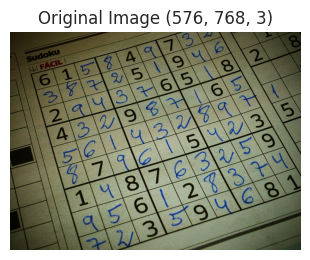

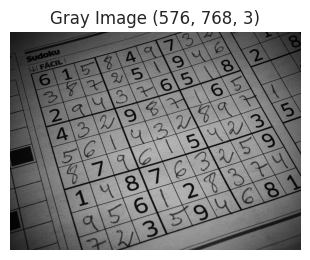

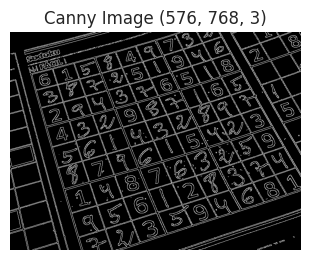

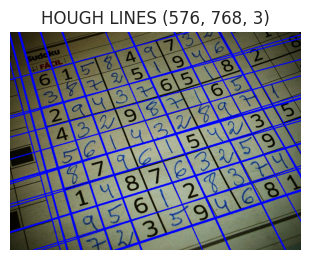

(63, 1, 4)


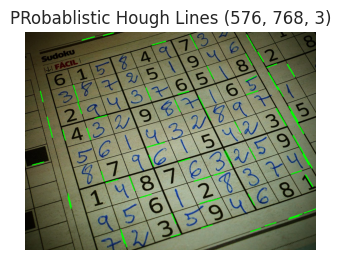

In [ ]:
image = cv2.imread('/content/images/soduku.jpg')
imageP = cv2.imread('/content/images/soduku.jpg')
imageshow(image , "Original Image")

gray = cv2.cvtColor(image , cv2.COLOR_BGR2GRAY)
imageshow(gray , "Gray Image")

edges = cv2.Canny(gray,100, 170 , apertureSize = 3)
imageshow(edges , "Canny Image")

lines = cv2.HoughLines(edges , 1, np.pi /180,240)


for line in lines:
    rho, theta = line[0]
    a = np.cos(theta)
    b = np.sin(theta)

    x0 = a * rho
    y0 = b * rho

    x1 = int(x0+1000 *(-b))
    y1 = int(y0 +1000 * (a))
    x2 = int(x0 - 1000 * (-b))
    y2 = int(y0 - 1000 * (a))

    cv2.line(image , (x1,y1),(x2,y2) , (255,0,0) , 2)

imageshow(image , "HOUGH LINES")

# Probablistic Hough lines

linesP = cv2.HoughLinesP(edges , 1 , np.pi/180 , 100 , 3 , 25)
print(linesP.shape)

for x in range(0 , len(linesP)):
    for x1,y1,x2,y2 in linesP[x]:
        cv2.line(imageP , (x1,y1),(x2,y2), (0,255,0) , 2)
imageshow(imageP, "PRobablistic Hough Lines")

## Circle Detection
```
cv2.HoughCircle(image , method , dp , MInDist , param1, param2, minRadius , MaxRadius)
```

In [ ]:
!wget https://raw.githubusercontent.com/rajeevratan84/ModernComputerVision/main/Circles_Packed_In_Square_11.jpeg

--2023-11-23 14:08:47--  https://raw.githubusercontent.com/rajeevratan84/ModernComputerVision/main/Circles_Packed_In_Square_11.jpeg
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.108.133, 185.199.109.133, 185.199.110.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.108.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 82585 (81K) [image/jpeg]
Saving to: ‘Circles_Packed_In_Square_11.jpeg’

Circles_Packed_In_S 100%[===================>]  80.65K  --.-KB/s    in 0.02s   

2023-11-23 14:08:47 (4.78 MB/s) - ‘Circles_Packed_In_Square_11.jpeg’ saved [82585/82585]



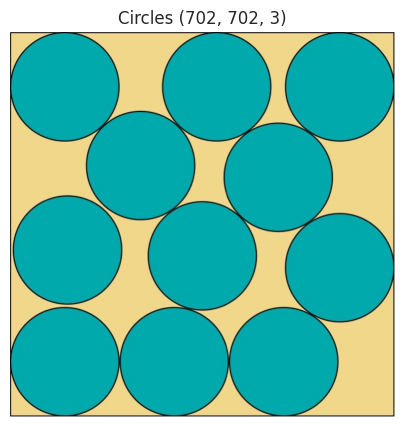

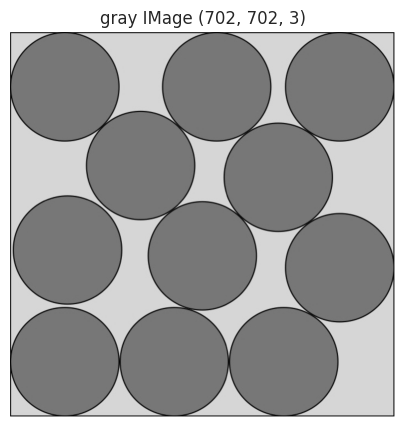

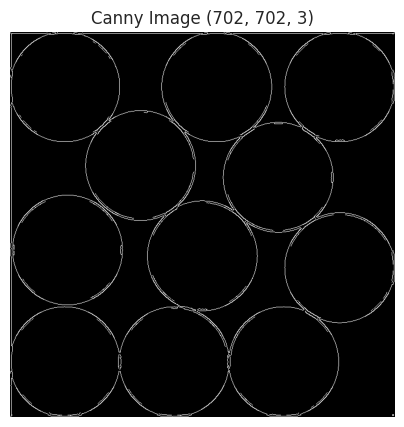

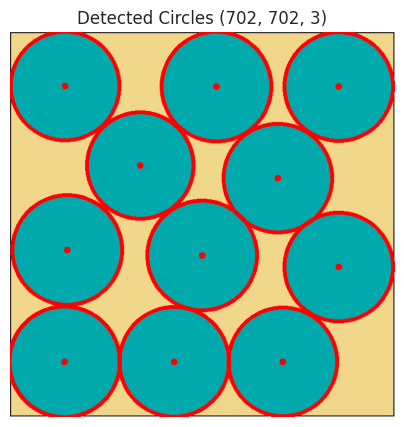

In [ ]:
image = cv2.imread("/content/Circles_Packed_In_Square_11.jpeg")
imageshow(image , "Circles")

gray = cv2.cvtColor(image , cv2.COLOR_BGR2GRAY )
imageshow(gray , "gray IMage")

blur = cv2.medianBlur(gray , 5)

canny = cv2.Canny(blur , 100 , 255 , 2)
imageshow(canny , "Canny Image")

circles = cv2.HoughCircles(blur , cv2.HOUGH_GRADIENT , 1.2 ,25)
cv2.HoughCircles(gray , cv2.HOUGH_GRADIENT , 1.2 , 100)


circles = np.uint16(np.around(circles))

for i in circles[0,:]:
    cv2.circle(image , (i[0] , i[1]) , i[2], (0,0,255), 5)
    cv2.circle(image ,(i[0] , i[1]) , 2 , (0,0,255), 8)

imageshow(image , "Detected Circles")

## Blob Detection
```
cv2.drawKeypoints(input_image , keypoints ,  blank_output_array , color ,flags)
```

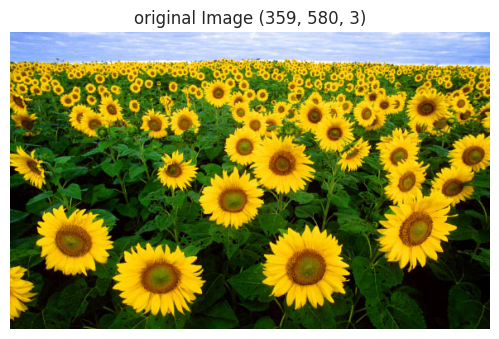

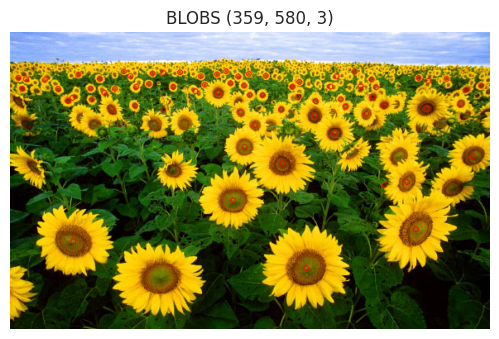

In [ ]:
image = cv2.imread("/content/images/Sunflowers.jpg")
imageshow(image , "original Image" , shape = 10)

detector = cv2.SimpleBlobDetector_create()

keypoints = detector.detect(image)

blank = np.zeros((1,1))

blobs = cv2.drawKeypoints(image , keypoints , blank , (0,0,255), cv2.DRAW_MATCHES_FLAGS_DEFAULT)

imageshow(blobs,"BLOBS", shape = 10)

## Counting Circular Blobs , Ellipses and Finding Waldo with Template Matching

# COunting CIrcular BLobs

![](https://i.stack.imgur.com/zYL2C.jpg)




![](https://github.com/rajeevratan84/ModernComputerVision/raw/main/simpleblob.png)

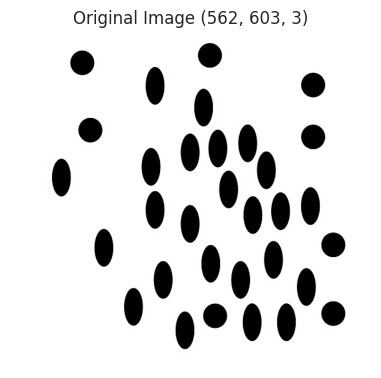

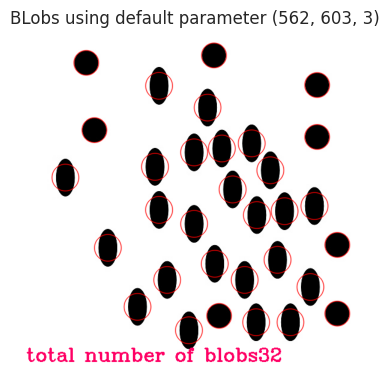

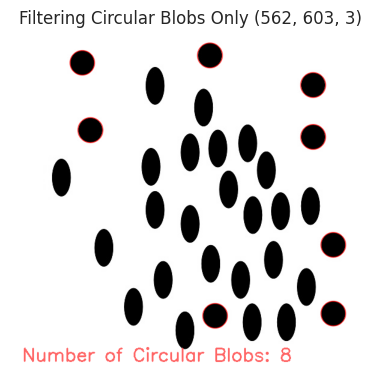

In [ ]:
image = cv2.imread("images/blobs.jpg" ,0)
imageshow(image , "Original Image")

detector = cv2.SimpleBlobDetector_create()

keypoints = detector.detect(image)

blank = np.zeros((1,1))
blobs = cv2.drawKeypoints(image , keypoints , blank , (0,0,255) , cv2.DrawMatchesFlags_DRAW_RICH_KEYPOINTS)

number_of_blobs = len(keypoints)

text = "total number of blobs" + str(number_of_blobs)
cv2.putText(blobs , text , (20,550), cv2.FONT_HERSHEY_COMPLEX , 1 ,(100,0,255), 2)

imageshow(blobs , "BLobs using default parameter")


# Set our filtering parameters
# Initialize parameter settiing using cv2.SimpleBlobDetector
params = cv2.SimpleBlobDetector_Params()

# Set Area filtering parameters
params.filterByArea = True
params.minArea = 100

# Set Circularity filtering parameters
params.filterByCircularity = True
params.minCircularity = 0.9

# Set Convexity filtering parameters
params.filterByConvexity = False
params.minConvexity = 0.2

# Set inertia filtering parameters
params.filterByInertia = True
params.minInertiaRatio = 0.01

# Create a detector with the parameters
detector = cv2.SimpleBlobDetector_create(params)

# Detect blobs
keypoints = detector.detect(image)

# Draw blobs on our image as red circles
blank = np.zeros((1,1))
blobs = cv2.drawKeypoints(image, keypoints, blank, (0,0,255),
                                      cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)

number_of_blobs = len(keypoints)
text = "Number of Circular Blobs: " + str(len(keypoints))
cv2.putText(blobs, text, (20, 550), cv2.FONT_HERSHEY_SIMPLEX, 1, (100, 100, 255), 2)

# Show blobs
imageshow(blobs,"Filtering Circular Blobs Only", )


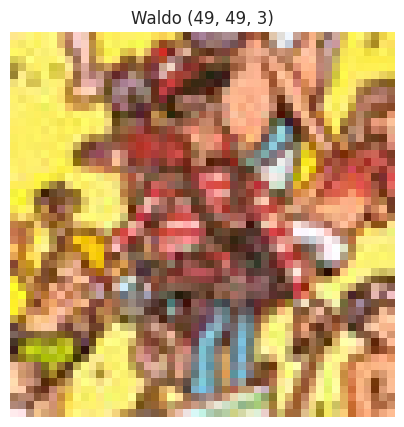

In [ ]:
image = cv2.imread("/content/images/waldo.jpg")
imageshow(image , "Waldo")

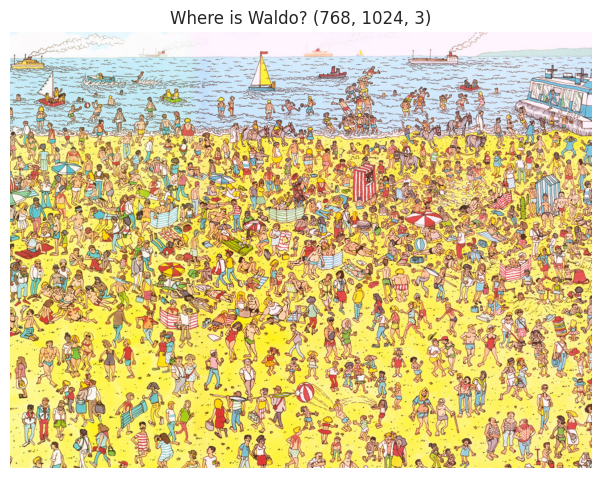

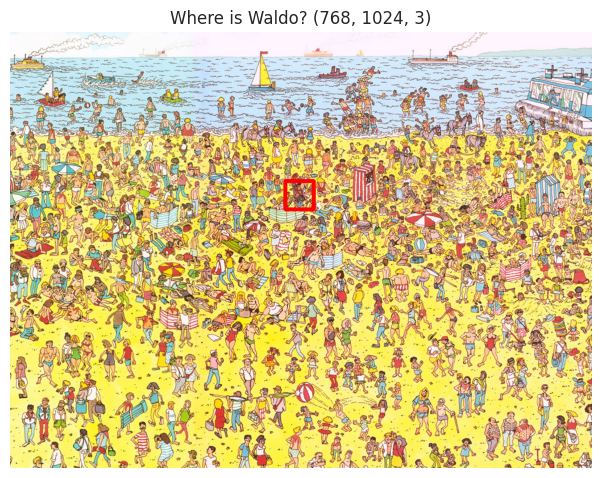

In [ ]:
# Load input image and convert to grayscale
image = cv2.imread('./images/WaldoBeach.jpg')
imageshow( image,'Where is Waldo?', shape =10)

gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

# Load Template image
template = cv2.imread('./images/waldo.jpg',0)

result = cv2.matchTemplate(gray, template, cv2.TM_CCOEFF)
min_val, max_val, min_loc, max_loc = cv2.minMaxLoc(result)

#Create Bounding Box
top_left = max_loc
bottom_right = (top_left[0] + 50, top_left[1] + 50)
cv2.rectangle(image, top_left, bottom_right, (0,0,255), 5)

imageshow( image,'Where is Waldo?',shape = 10)

![](https://github.com/rajeevratan84/ModernComputerVision/raw/main/logo_MCV_W.png)

# **Finding Corners**

####**In this lesson we'll learn:**
1. To use Harris Corners to find corners
2. Use Good Features to Track

## **What is a Corner?**

A corner is a point whose local neighborhood stands in two dominant and different edge directions. In other words, a corner can be interpreted as the junction of two edges, where an edge is a sudden change in image brightness. Corners are the important features in the image, and they are generally termed as interest points which are invariant to translation, rotation, and illumination.

![](https://github.com/rajeevratan84/ModernComputerVision/raw/main/edge.png)

### **Harris Corner Detection** is an algorithm developed in 1988 for corner detection that works fairly well.


**Paper** - http://www.bmva.org/bmvc/1988/avc-88-023.pdf

**cv2.cornerHarris**(input image, block size, ksize, k)
- Input image - should be grayscale and float32 type.
- blockSize - the size of neighborhood considered for corner detection
- ksize - aperture parameter of Sobel derivative used.
- k - harris detector free parameter in the equation
- **Output** – array of corner locations (x,y)




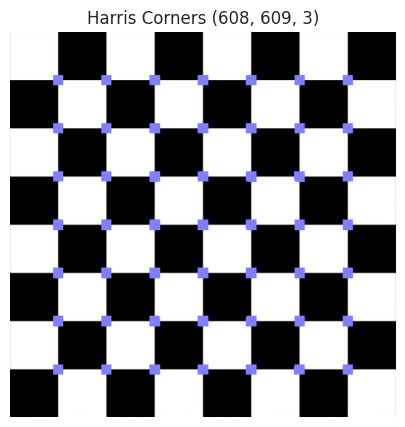

In [ ]:
# Load image then grayscale
image = cv2.imread('images/chess.JPG')
gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

# The cornerHarris function requires the array datatype to be float32
gray = np.float32(gray)

harris_corners = cv2.cornerHarris(gray, 3, 3, 0.05)

#We use dilation of the corner points to enlarge them\
kernel = np.ones((7,7),np.uint8)
harris_corners = cv2.dilate(harris_corners, kernel, iterations = 2)

# Threshold for an optimal value, it may vary depending on the image.
image[harris_corners > 0.025 * harris_corners.max() ] = [255, 127, 127]

imageshow( image,'Harris Corners')

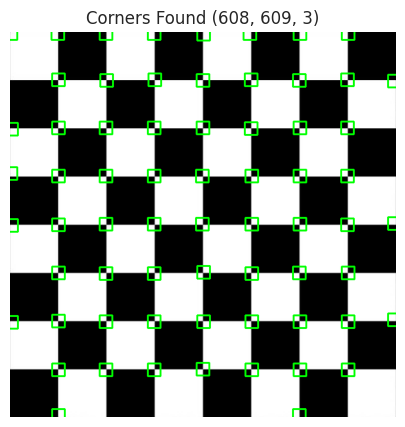

In [ ]:
img = cv2.imread('images/chess.JPG')
gray = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)

# We specific the top 50 corners
corners = cv2.goodFeaturesToTrack(gray, 150, 0.0005, 10)

for corner in corners:
    x, y = corner[0]
    x = int(x)
    y = int(y)
    cv2.rectangle(img,(x-10,y-10),(x+10,y+10),(0,255,0), 2)

imageshow( img,"Corners Found")

## face and EYE Detection using Cascade Haarcascade Classifier

## **Simple Face Detection using Haarcascade Classifiers**

### **Firstly, What is Object Detection?**

![](https://miro.medium.com/max/739/1*zlWrCk1hBBFRXa5t84lmHQ.jpeg)

**Object Detection** is the ability to detect and classify individual objects in an image and draw a bounding box over the object's area.

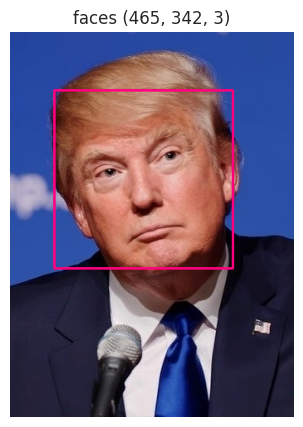

In [ ]:


# Load the Haar Cascade Classifier for face detection
face_classifier = cv2.CascadeClassifier(
    cv2.data.haarcascades + "haarcascade_frontalface_default.xml"
)

# Load the image
image = cv2.imread('images/Trump.jpg')

# Convert the image to grayscale
gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

# Detect faces in the grayscale image
faces = face_classifier.detectMultiScale(gray, scaleFactor=1.3, minNeighbors=5)

# Check if any faces were detected
if len(faces) == 0:
    print("No faces found")
else:
    # Iterate through the detected faces and draw rectangles around them
    for (x, y, w, h) in faces:
        cv2.rectangle(image, (x, y), (x + w, y + h), (127, 0, 255), 2)

    # Display the image with rectangles drawn around the faces
    imageshow(image , "faces")


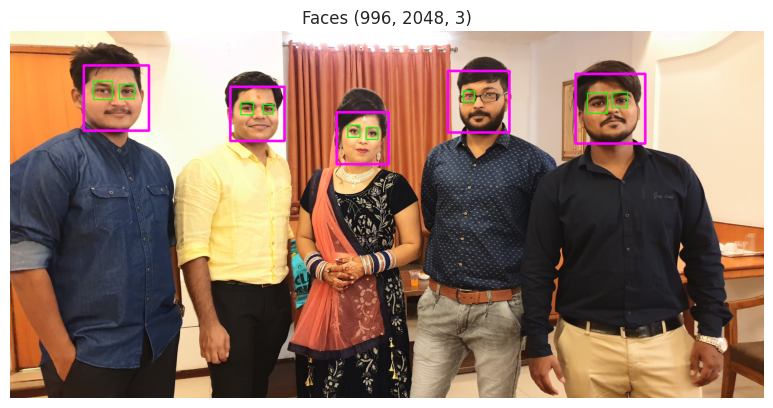

In [ ]:
image = cv2.imread("/content/20190512_134603.jpg" )
# imageshow(image , "Bhai log", shape = 10)

face_classifier = cv2.CascadeClassifier(
    cv2.data.haarcascades + "haarcascade_frontalface_default.xml"
)
eye_classifier = cv2.CascadeClassifier(
    cv2.data.haarcascades + "haarcascade_eye.xml"
)

profile_classifier = cv2.CascadeClassifier(
    cv2.data.haarcascades + "haarcascade_profileface.xml"
)

glass_classifier = cv2.CascadeClassifier(
    cv2.data.haarcascades + "haarcascade_eye_tree_eyeglasses.xml"
)


gray = cv2.cvtColor(image , cv2.COLOR_BGR2GRAY)

faces = face_classifier.detectMultiScale(gray , 1.3 , 5)

profile = profile_classifier.detectMultiScale(gray , 1.3 , 5)


eye = eye_classifier.detectMultiScale(gray , 1.3 , 5)




if len(faces) == 0:
    print("No face detected")

else:
    for (x, y, w, h) in faces:
        cv2.rectangle(image, (x, y), (x + w, y + h), (255,0, 255),5 )

    for (x, y, w, h) in profile:
        cv2.rectangle(image, (x, y), (x + w, y + h), (255, 255, 0), 5)

    for (x, y, w, h) in eye:
        cv2.rectangle(image, (x, y), (x + w, y + h), (0, 255, 0), 2)

    imageshow(image , "Faces", shape = 20)

In [ ]:
from IPython.display import display, Javascript
from google.colab.output import eval_js
from base64 import b64decode

def take_photo(filename='photo.jpg', quality=1):
  js = Javascript('''
    async function takePhoto(quality) {
      const div = document.createElement('div');
      const capture = document.createElement('button');
      capture.textContent = 'Capture';
      div.appendChild(capture);

      const video = document.createElement('video');
      video.style.display = 'block';
      const stream = await navigator.mediaDevices.getUserMedia({video: true});

      document.body.appendChild(div);
      div.appendChild(video);
      video.srcObject = stream;
      await video.play();

      // Resize the output to fit the video element.
      google.colab.output.setIframeHeight(document.documentElement.scrollHeight, true);

      // Wait for Capture to be clicked.
      await new Promise((resolve) => capture.onclick = resolve);

      const canvas = document.createElement('canvas');
      canvas.width = video.videoWidth;
      canvas.height = video.videoHeight;
      canvas.getContext('2d').drawImage(video, 0, 0);
      stream.getVideoTracks()[0].stop();
      div.remove();
      return canvas.toDataURL('image/jpeg', quality);
    }
    ''')
  display(js)
  data = eval_js('takePhoto({})'.format(quality))
  binary = b64decode(data.split(',')[1])
  with open(filename, 'wb') as f:
    f.write(binary)
  return filename

In [ ]:
from IPython.display import Image
try:
  filename = take_photo()
  print('Saved to {}'.format(filename))

  # Show the image which was just taken.
  display(Image(filename))
except Exception as err:
  # Errors will be thrown if the user does not have a webcam or if they do not
  # grant the page permission to access it.
  print(str(err))

In [ ]:
from IPython.display import Image
try:
  filename = take_photo()
  print('Saved to {}'.format(filename))

  # Show the image which was just taken.
  display(Image(filename))
except Exception as err:
  # Errors will be thrown if the user does not have a webcam or if they do not
  # grant the page permission to access it.
  print(str(err))

image = cv2.imread("/content/photo.jpg")



face_classifier = cv2.CascadeClassifier(
    cv2.data.haarcascades + "haarcascade_frontalface_default.xml"
)
eye_classifier = cv2.CascadeClassifier(
    cv2.data.haarcascades + "haarcascade_eye.xml"
)

profile_classifier = cv2.CascadeClassifier(
    cv2.data.haarcascades + "haarcascade_profileface.xml"
)

glass_classifier = cv2.CascadeClassifier(
    cv2.data.haarcascades + "haarcascade_eye_tree_eyeglasses.xml"
)


gray = cv2.cvtColor(image , cv2.COLOR_BGR2GRAY)

faces = face_classifier.detectMultiScale(gray , 1.3 , 5)

profile = profile_classifier.detectMultiScale(gray)


eye = eye_classifier.detectMultiScale(gray , 1.3 , 5)




if len(faces) == 0:
    print("No face detected")

else:
    for (x, y, w, h) in faces:
        cv2.rectangle(image, (x, y), (x + w, y + h), (255, 120, 255),5 )

    for (x, y, w, h) in profile:
        cv2.rectangle(image, (x, y), (x + w, y + h), (0, 0, 0), 2)

    for (x, y, w, h) in eye:
        cv2.rectangle(image, (x, y), (x + w, y + h), (0, 255, 0), 2)

    imageshow(image , "Faces" , shape = 10)

# **Vehicle and Pedestrian Detection**

####**In this lesson we'll learn:**
1. Use a Haarcascade classier to detect Pedestrians
2. Use our Haarcascade classifiers on videos
3. Use a Haarcascade classier to detect Vehicles or cars


In [ ]:
cap = cv2.VideoCapture("/content/images/walking.avi")


# Load our body classifier
body_classifier = cv2.CascadeClassifier(
    cv2.data.haarcascades + "haarcascade_fullbody.xml"
)

# Read first frame
ret, frame = cap.read()

# Ret is True if successfully read
if ret:

  #Grayscale our image for faster processing
  gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)

  # Pass frame to our body classifier
  bodies = body_classifier.detectMultiScale(gray, 1.3, 3)

  # Extract bounding boxes for any bodies identified
  for (x,y,w,h) in bodies:
      cv2.rectangle(frame, (x, y), (x+w, y+h), (0, 255, 255), 2)

# Release our video capture
cap.release()
imageshow(frame,"Pedestrian Detector",shape = 10)

In [ ]:
# Create our video capturing object
cap = cv2.VideoCapture('walking.avi')

# Get the height and width of the frame (required to be an interfer)
w = int(cap.get(3))
h = int(cap.get(4))

# Define the codec and create VideoWriter object.The output is stored in 'walking_output.avi' file.
out = cv2.VideoWriter('walking_output.avi', cv2.VideoWriter_fourcc('M','J','P','G'), 30, (w, h))

body_detector = cv2.CascadeClassifier(
    cv2.data.haarcascades + "haarcascade_fullbody.xml"
)

# Loop once video is successfully loaded
while(True):

  ret, frame = cap.read()
  if ret:

    gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)

    # Pass frame to our body classifier
    bodies = body_detector.detectMultiScale(gray, 1.2, 3)

    # Extract bounding boxes for any bodies identified
    for (x,y,w,h) in bodies:
        cv2.rectangle(frame, (x, y), (x+w, y+h), (0, 255, 255), 2)

    # Write the frame into the file 'output.avi'
    out.write(frame)
  else:
      break

cap.release()
out.release()